In [1]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import seaborn as sns

import scipy.stats as stats
from scipy.stats import norm
from scipy.special import boxcox1p

import statsmodels
import statsmodels.api as sm
#print(statsmodels.__version__)
import warnings
warnings.filterwarnings('ignore') #cảnh báo và tắt các cảnh báo
plt.style.use('fivethirtyeight') 

In [2]:
dfboj = pd.read_csv('MOFJ-INTEREST_RATE_JAPAN.csv', parse_dates=['Date'], index_col = 'Date')
dfboj.tail(10)

,1Y,2Y,3Y,4Y,5Y,6Y,7Y,8Y,9Y,10Y,15Y,20Y,25Y,30Y,40Y
Date,,,,,,,,,,,,,,,
1974-10-04,10.395,9.379,8.840,8.521,8.355,8.298,8.244,8.120,8.204,NaN,NaN,NaN,NaN,NaN,NaN
1974-10-03,10.388,9.378,8.839,8.520,8.354,8.298,8.244,8.120,8.203,NaN,NaN,NaN,NaN,NaN,NaN
1974-10-02,10.381,9.376,8.838,8.520,8.354,8.298,8.244,8.119,8.202,NaN,NaN,NaN,NaN,NaN,NaN
1974-10-01,10.374,9.374,8.837,8.519,8.354,8.298,8.244,8.119,8.201,NaN,NaN,NaN,NaN,NaN,NaN
1974-09-30,10.368,9.373,8.836,8.519,8.350,8.291,8.240,8.122,8.130,NaN,NaN,NaN,NaN,NaN,NaN
1974-09-28,10.354,9.369,8.834,8.518,8.349,8.291,8.240,8.122,8.129,NaN,NaN,NaN,NaN,NaN,NaN
1974-09-27,10.347,9.367,8.833,8.517,8.349,8.290,8.240,8.122,8.128,NaN,NaN,NaN,NaN,NaN,NaN
1974-09-26,10.340,9.366,8.832,8.516,8.348,8.290,8.240,8.122,8.128,NaN,NaN,NaN,NaN,NaN,NaN
1974-09-25,10.333,9.364,8.831,8.516,8.348,8.290,8.240,8.121,8.127,NaN,NaN,NaN,NaN,NaN,NaN


In [3]:
dffed = pd.read_csv('US_Treasury_Yield.csv')
dffed = dffed.iloc[5:]
dffed.columns = dffed.columns.str.replace(' +', ' ', regex=True)
dffed = dffed.rename(columns = {'Series Description':'Date',
        'Market yield on U.S. Treasury securities at 1-month constant maturity, quoted on investment basis':'1M',
       'Market yield on U.S. Treasury securities at 3-month constant maturity, quoted on investment basis':'3M',
       'Market yield on U.S. Treasury securities at 6-month constant maturity, quoted on investment basis':'6M',
       'Market yield on U.S. Treasury securities at 1-year constant maturity, quoted on investment basis':'1Y',
       'Market yield on U.S. Treasury securities at 2-year constant maturity, quoted on investment basis':'2Y',
       'Market yield on U.S. Treasury securities at 3-year constant maturity, quoted on investment basis':'3Y',
       'Market yield on U.S. Treasury securities at 5-year constant maturity, quoted on investment basis':'5Y',
       'Market yield on U.S. Treasury securities at 7-year constant maturity, quoted on investment basis':'7Y',
       'Market yield on U.S. Treasury securities at 10-year constant maturity, quoted on investment basis':'10Y',
       'Market yield on U.S. Treasury securities at 20-year constant maturity, quoted on investment basis':'20Y',
       'Market yield on U.S. Treasury securities at 30-year constant maturity, quoted on investment basis':'30Y'})
dffed['Date']=pd.to_datetime(dffed['Date'])
dffed = dffed.set_index('Date')
for c in dffed.columns:
    dffed[c] = pd.to_numeric(dffed[c], errors='coerce')
dffed.tail(12)


,1M,3M,6M,1Y,2Y,3Y,5Y,7Y,10Y,20Y,30Y
Date,,,,,,,,,,,
2024-01-29,5.53,5.42,5.19,4.76,4.29,4.10,3.97,4.02,4.08,4.42,4.31
2024-01-30,5.53,5.42,5.19,4.80,4.36,4.14,4.00,4.03,4.06,4.40,4.28
2024-01-31,5.53,5.42,5.18,4.73,4.27,4.05,3.91,3.95,3.99,4.34,4.22
2024-02-01,5.49,5.42,5.15,4.68,4.20,3.96,3.80,3.83,3.87,4.21,4.10
2024-02-02,5.49,5.43,5.22,4.81,4.36,4.14,3.99,4.02,4.03,4.33,4.22
2024-02-05,5.49,5.42,5.25,4.87,4.46,4.27,4.13,4.16,4.17,4.46,4.35
2024-02-06,5.48,5.44,5.23,4.82,4.39,4.14,4.03,4.07,4.09,4.39,4.29
2024-02-07,5.47,5.43,5.23,4.83,4.41,4.16,4.06,4.09,4.09,4.41,4.31
2024-02-08,5.49,5.44,5.24,4.83,4.46,4.22,4.12,4.15,4.15,4.47,4.36


In [4]:
for c in dffed.columns:
    dffed = dffed.rename(columns = {c: 'FFR'+c})
dffed.tail()
for c in dfboj.columns:
    dfboj = dfboj.rename(columns = {c: 'JPN_'+c})
dfboj.head()

df = dfboj.join(dffed, how='outer')

for c in dffed.columns:
    dffed = dffed.rename(columns = {c: c[3:]})

for c in dfboj.columns:
    dfboj = dfboj.rename(columns = {c: c[4:]})   
df.tail()

,JPN_1Y,JPN_2Y,JPN_3Y,JPN_4Y,JPN_5Y,JPN_6Y,JPN_7Y,JPN_8Y,JPN_9Y,JPN_10Y,...,FFR3M,FFR6M,FFR1Y,FFR2Y,FFR3Y,FFR5Y,FFR7Y,FFR10Y,FFR20Y,FFR30Y
Date,,,,,,,,,,,,,,,,,,,,,
2024-02-07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,5.43,5.23,4.83,4.41,4.16,4.06,4.09,4.09,4.41,4.31
2024-02-08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,5.44,5.24,4.83,4.46,4.22,4.12,4.15,4.15,4.47,4.36
2024-02-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,5.44,5.26,4.86,4.48,4.25,4.14,4.17,4.17,4.48,4.37
2024-02-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,5.43,5.27,4.87,4.46,4.25,4.13,4.16,4.17,4.48,4.37
2024-02-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,5.45,5.32,4.99,4.64,4.44,4.31,4.33,4.31,4.59,4.46


In [5]:
fed_sum = dffed.describe()
fed_sum = fed_sum.transpose()
fed_sum

,count,mean,std,min,25%,50%,75%,max
1M,5637.0,1.408847,1.665674,0.00,0.06,0.87,2.1400,6.02
3M,10613.0,3.793082,3.195786,0.00,0.79,3.71,5.7100,17.01
6M,10613.0,3.972977,3.302977,0.02,0.95,3.93,5.9000,17.43
1Y,15515.0,4.902675,3.409700,0.04,2.20,4.97,6.7900,17.31
2Y,11923.0,5.002161,3.742536,0.09,1.61,4.78,7.2600,16.95
3Y,15515.0,5.289745,3.297349,0.10,2.73,5.21,7.2600,16.59
5Y,15515.0,5.540531,3.170739,0.19,3.16,5.43,7.4600,16.27
7Y,13645.0,5.877744,3.236030,0.36,3.13,6.00,7.8400,16.05
10Y,15515.0,5.867427,2.972389,0.52,3.85,5.61,7.6200,15.84
20Y,13826.0,5.898095,2.880615,0.87,4.02,5.37,7.3675,15.78


In [6]:
boj_sum = dfboj.describe()
boj_sum = boj_sum.transpose()
boj_sum

,count,mean,std,min,25%,50%,75%,max
1Y,10922.0,2.865854,3.314076,-0.371,0.098,0.6290,6.20475,11.237
2Y,11209.0,3.096318,3.362152,-0.372,0.130,0.8980,6.40100,12.145
3Y,11494.0,3.264740,3.301951,-0.374,0.237,1.3765,6.61400,11.701
4Y,11570.0,3.370830,3.214007,-0.376,0.384,1.8725,6.60800,10.562
5Y,11570.0,3.478160,3.176900,-0.384,0.525,2.2760,6.61175,10.656
6Y,11570.0,3.596006,3.164342,-0.405,0.680,2.6050,6.67975,10.639
7Y,11570.0,3.691647,3.136702,-0.423,0.842,2.8650,6.76875,10.858
8Y,11570.0,3.773502,3.073194,-0.389,1.013,3.0345,6.77175,10.940
9Y,11570.0,3.837382,3.018579,-0.350,1.179,3.1350,6.73500,10.670
10Y,8209.0,2.343132,1.980887,-0.297,0.972,1.5500,4.11100,8.105


Aggregate statistics vs. bond duration

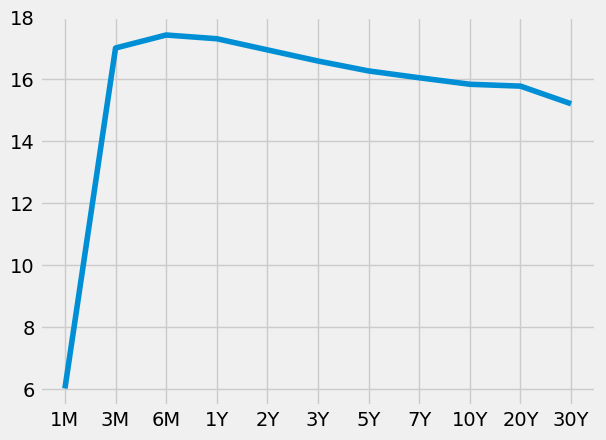

In [7]:
plt.plot(fed_sum['max'])

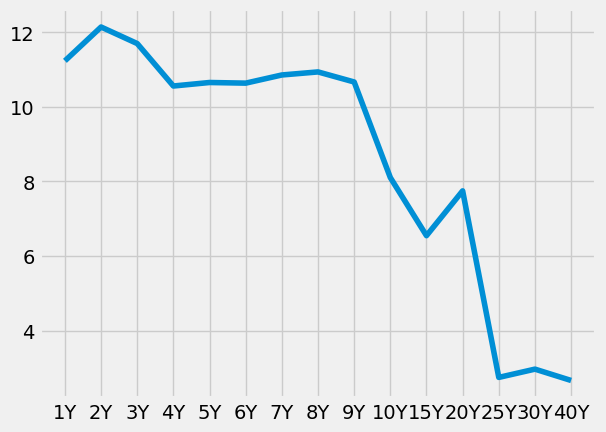

In [8]:
plt.plot(boj_sum['max'])

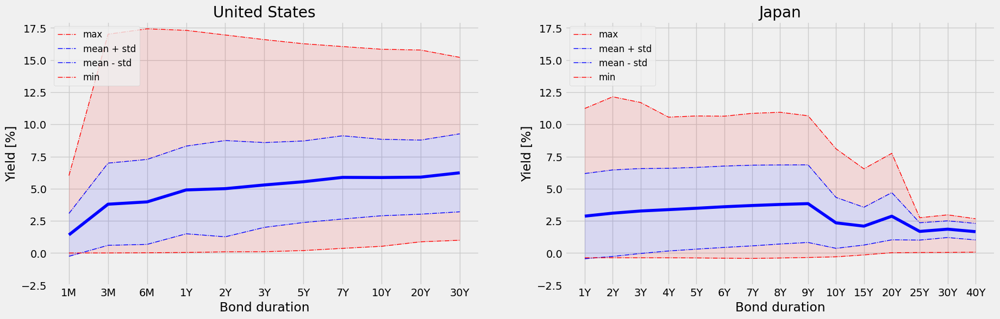

In [9]:
def plot_data(ax, data, title):
    ax.plot(data['max'], color='red', linestyle = '-.', linewidth=1, label = 'max')
    ax.plot(data['mean'] + data['std'], color='blue', linestyle = '-.', linewidth=1, label = 'mean + std')
    ax.plot(data['mean'], color='blue')
    ax.plot(data['mean'] - data['std'], color='blue', linestyle = '-.', linewidth=1, label = 'mean - std')
    ax.plot(data['min'], color='red', linestyle = '-.', linewidth=1, label = 'min')
    ax.fill_between(data.index, data['min'], data['mean'] - data['std'], color='r', alpha=.1)
    ax.fill_between(data.index, data['mean'] + data['std'], data['max'], color='r', alpha=.1)
    ax.fill_between(data.index, data['mean'] - data['std'], data['mean'] + data['std'], color='b', alpha=.1)
    ax.legend(fontsize=12, loc = 'upper left')
    ax.set_ylim(-2.5, 18)
    ax.set_xlabel('Bond duration')
    ax.set_ylabel('Yield [%]')
    ax.set_title(title)

fig, ax = plt.subplots(1, 2, figsize=(20,6))

plot_data(ax[0], fed_sum, 'United States')
plot_data(ax[1], boj_sum, 'Japan')


Time series plots for given bond duration

US
Some observations:

1. Since the end of the COVID-19 pandemic, the yield on short-term government bonds has been trending upwards. This surge can be attributed to geopolitical conflicts, rampant inflation, and disruptions in the global supply chain, all of which have contributed to an inverse yield curve.
2. There was a huge spike in yield on 1M government debt around 2004-2008, presumably associated with the financial crisis.
3. Bond yields of medium (1Y-10Y) duration had a huge spike in the early 1980s.
4. The overall trend in yields since the 1980s is downward for medium and long (>1Y) duration bonds.

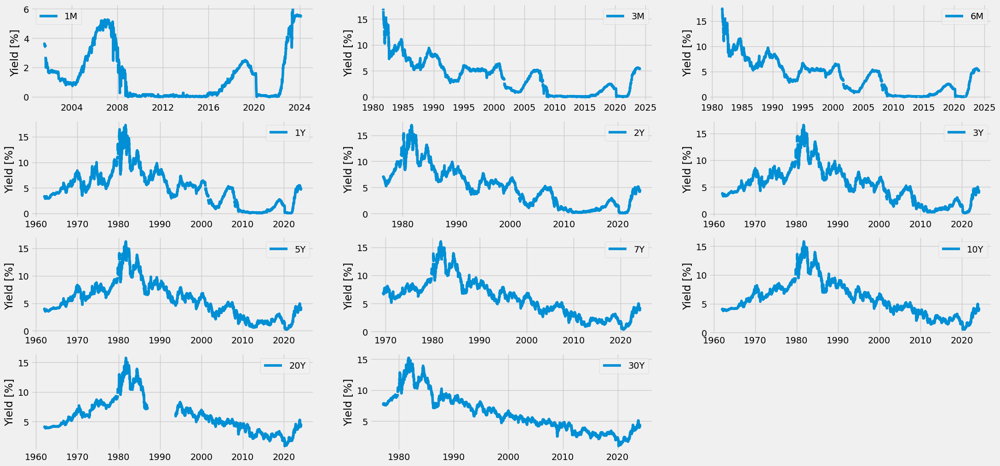

In [10]:
fig, ax = plt.subplots(4,3,figsize=(24, 12))
for i, c in enumerate(dffed.columns):
    ax[i//3][i%3].plot(dffed[c], label = c )
    ax[i//3][i%3].legend()
    ax[i//3][i%3].set_ylabel('Yield [%]')
fig.delaxes(ax[3][2])

Japan
Some observations:

1. There was a spike in yields of short and medium (<15Y) duration bonds around 1990.
2. Since 1995 the yields on short and medium (<15Y) duration bonds have been extremely low.
3. In the period since 1995 long (>10Y) maturity yields have been higher than short term yields but there is an overall downward trend.

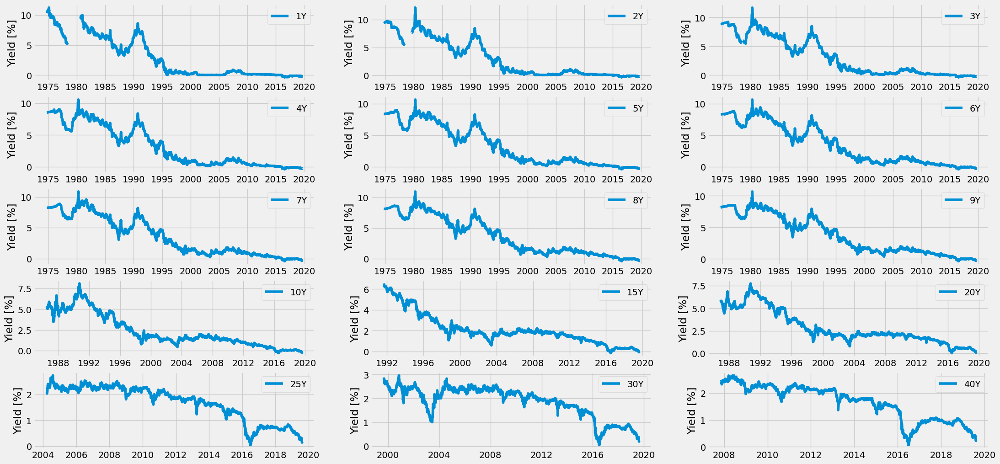

In [11]:
fig, ax = plt.subplots(5,3,figsize=(24, 12))
for i, c in enumerate(dfboj.columns):
    ax[i//3][i%3].plot(dfboj[c], label = c )
    ax[i//3][i%3].set_ylabel('Yield [%]')
    ax[i//3][i%3].legend()

Correlations between bonds of different duration

Text(0.5, 1.0, 'Japan')

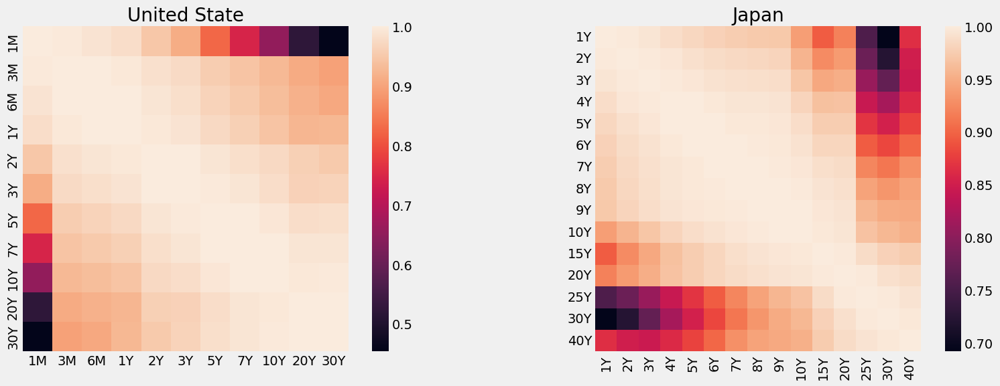

In [12]:
f, ax = plt.subplots(1,2, figsize=(18,6))
corrmatrixfed = dffed.corr(numeric_only=True)
sns.heatmap(corrmatrixfed, square=True, ax=ax[0])
ax[0].set_title('United State')
corrmatrixboj = dfboj.corr(numeric_only=True)
sns.heatmap(corrmatrixboj, square=True, ax=ax[1])
ax[1].set_title('Japan')

In [13]:
dffed.columns

Index(['1M', '3M', '6M', '1Y', '2Y', '3Y', '5Y', '7Y', '10Y', '20Y', '30Y'], dtype='object')

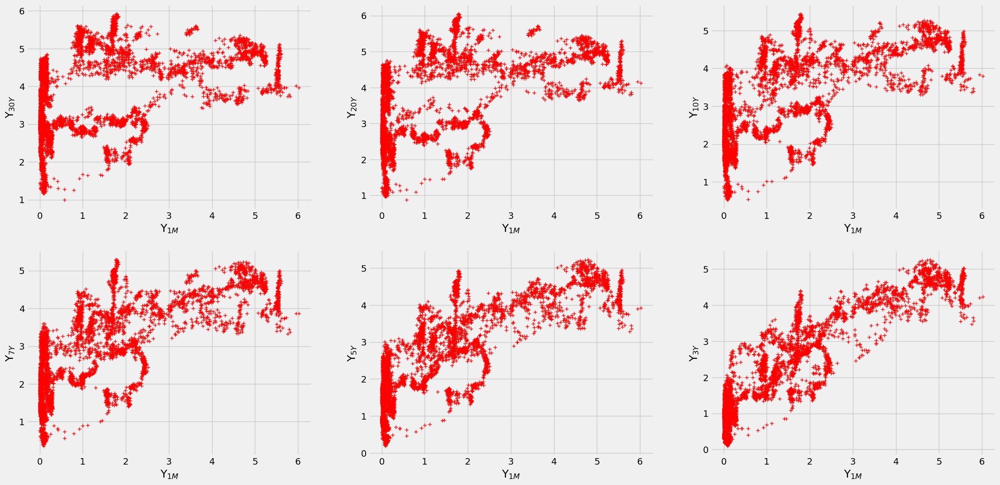

In [14]:
fig, ax = plt.subplots(2,3, figsize=(24, 12))
for i, c in enumerate(['30Y', '20Y', '10Y', '7Y', '5Y', '3Y']):
    ax[i//3][i%3].plot(dffed['1M'], dffed[c],'r+')
    ax[i//3][i%3].set_xlabel('Y$_{1M}$')
    ax[i//3][i%3].set_ylabel('Y$_{'+c+'}$')

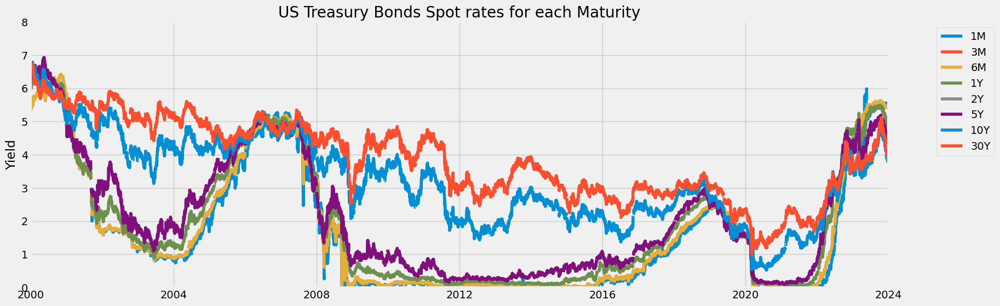

In [15]:
fig, ax = plt.subplots(figsize=(18,6))
ax.plot(dffed['1M'], label='1M')
ax.plot(dffed['3M'], label='3M')
ax.plot(dffed['3M'], label='6M')
ax.plot(dffed['1Y'], label='1Y')
ax.plot(dffed['2Y'], label='2Y')
ax.plot(dffed['2Y'], label='5Y')
ax.plot(dffed['10Y'], label='10Y')
ax.plot(dffed['30Y'], label='30Y')
ax.set_xlim(pd.to_datetime('2000-01-01'), pd.to_datetime('2024-01-01'))
ax.set_ylim(0, 8)
ax.set_ylabel('Yield')
ax.set_title('US Treasury Bonds Spot rates for each Maturity')
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()


In [16]:
dfboj.columns

Index(['1Y', '2Y', '3Y', '4Y', '5Y', '6Y', '7Y', '8Y', '9Y', '10Y', '15Y',
       '20Y', '25Y', '30Y', '40Y'],
      dtype='object')

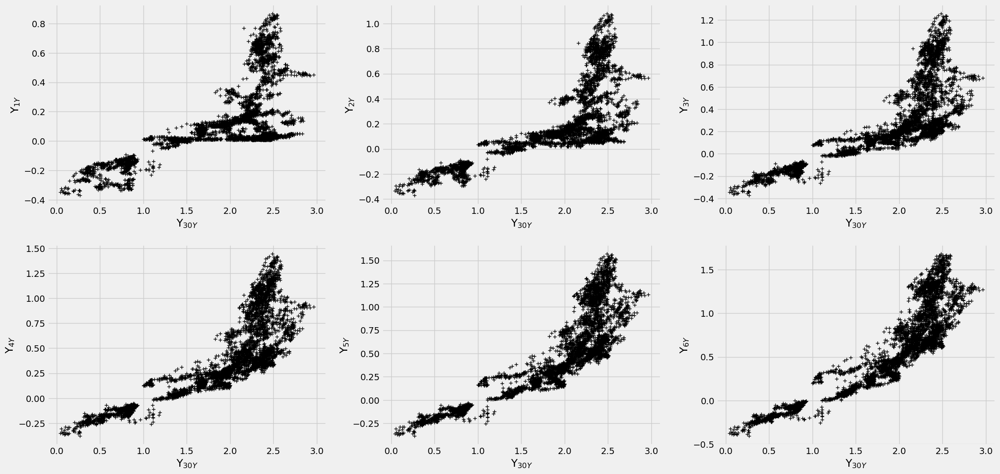

In [17]:
fig, ax = plt.subplots(2,3, figsize=(24, 12))
for i, c in enumerate(['1Y', '2Y', '3Y', '4Y', '5Y', '6Y']):
    ax[i//3][i%3].plot(dfboj['30Y'], dfboj[c],'k+')
    ax[i//3][i%3].set_xlabel('Y$_{30Y}$')
    ax[i//3][i%3].set_ylabel('Y$_{'+c+'}$')

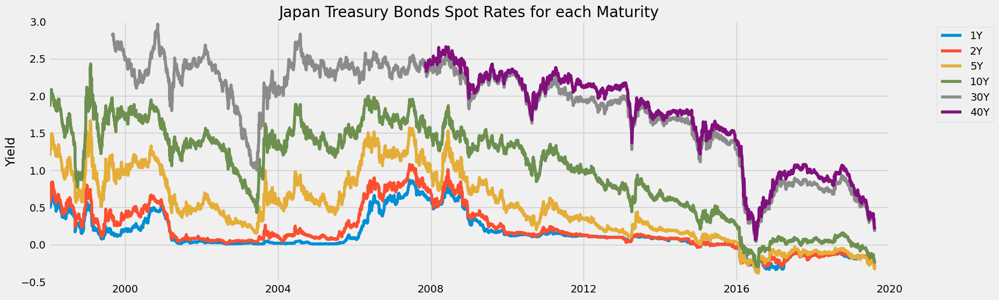

In [18]:
fig, ax = plt.subplots(figsize=(18,6))
ax.plot(dfboj['1Y'], label='1Y')
ax.plot(dfboj['2Y'], label='2Y')
ax.plot(dfboj['5Y'], label='5Y')
ax.plot(dfboj['10Y'], label='10Y')
ax.plot(dfboj['30Y'], label='30Y')
ax.plot(dfboj['40Y'], label='40Y')
ax.set_xlim(pd.to_datetime('1998-01-01'), pd.to_datetime('2020-01-01'))
ax.set_ylim(-0.5, 3)
ax.set_ylabel('Yield')
ax.set_title('Japan Treasury Bonds Spot Rates for each Maturity')
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()


Text(0.5, 1.0, 'United State and Japan')

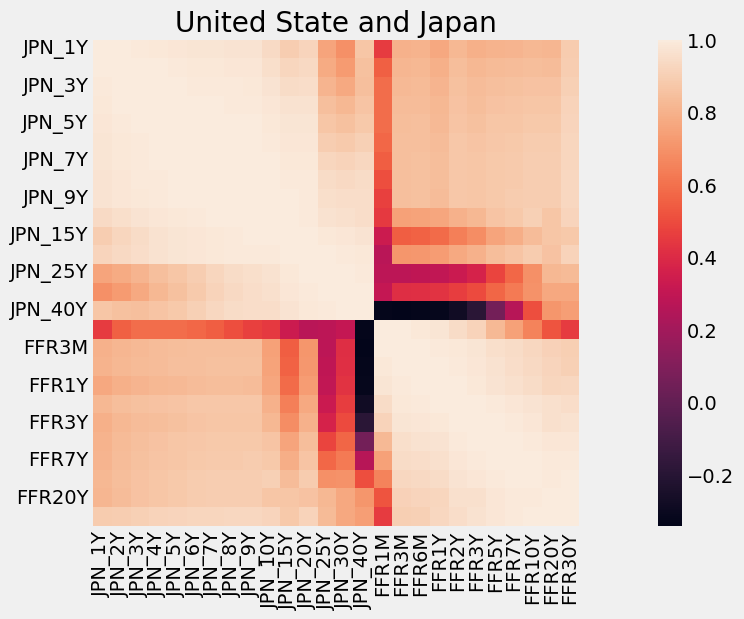

In [19]:
f, ax = plt.subplots(figsize=(18,6))
corrmatrix = df.corr()
sns.heatmap(corrmatrix, square=True, ax=ax)
ax.set_title('United State and Japan')

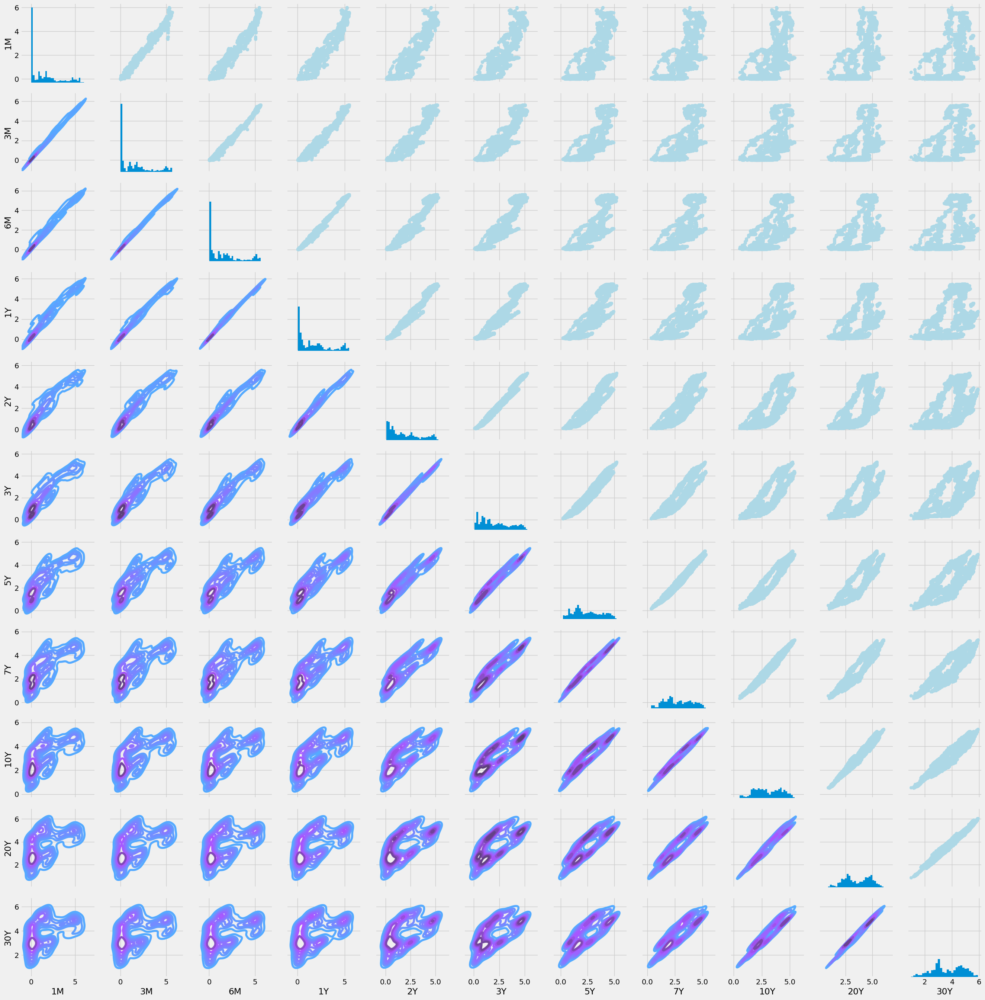

In [20]:
import seaborn as sns
# Create a pair grid of the data using Seaborn
dffed_plot=sns.PairGrid(dffed.dropna())
dffed_plot.map_upper(plt.scatter, color='lightblue')
dffed_plot.map_lower(sns.kdeplot, cmap='cool_d')
dffed_plot.map_diag(plt.hist, bins=30)

<Axes: xlabel='Date'>

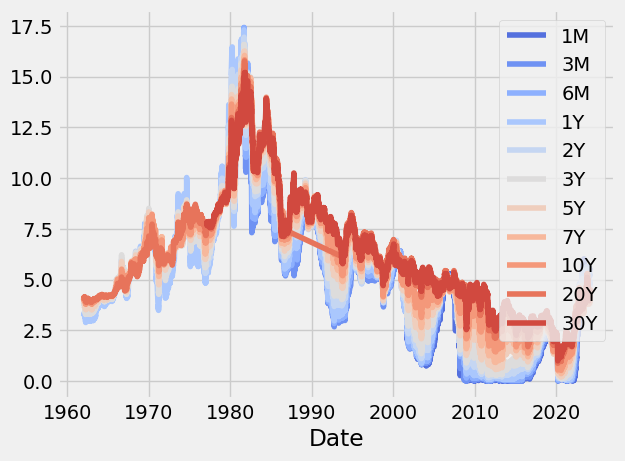

In [20]:
import seaborn as sb
sb.lineplot(data = dffed[['1M', '3M','6M', '1Y', '2Y', '3Y', '5Y', '7Y', '10Y', '20Y', '30Y']], dashes = False, palette = 'coolwarm')

Yield curve inversions

Recently (week of Jan 2nd 2024) the US T-bill yield curve inverted - yield on short term government was higher than that on long-term government bonds. This is a well-known sign of an economic downturn.

Motivated by this, I'm going to look at when this occured historically both in the US and Japan. I made the figures large because inversions occur in narrow time-windows and are hard to spot if the axes are too small.

US - 10 year vs. 2 year

Text(0, 0.5, 'Yield$_{10Y}$ - Yield$_{2Y}$')

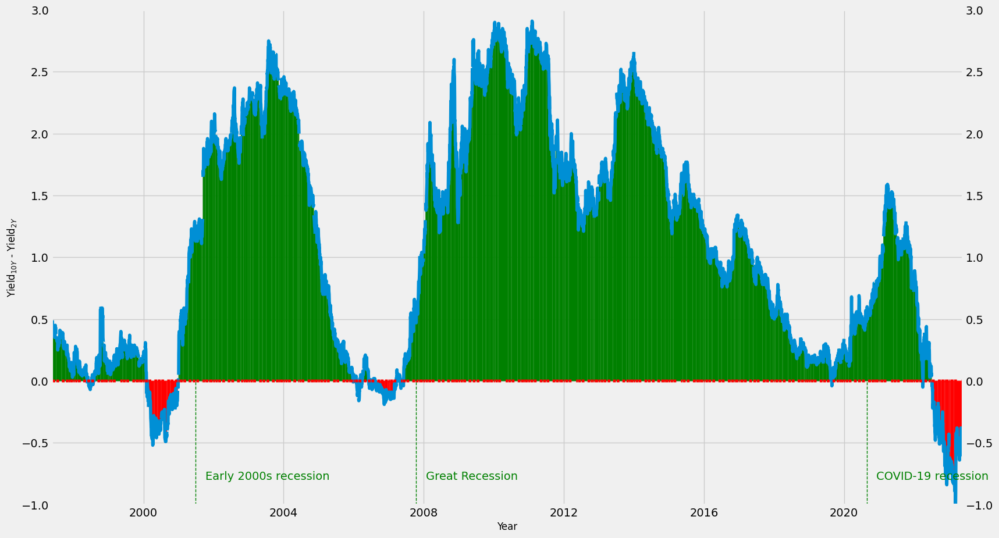

In [21]:
fig, ax = plt.subplots(figsize=(18,10.5))
diff = dffed['10Y'] - dffed['2Y']
plt.plot(dffed.index, diff)
plt.fill_between(dffed.index, 0, diff, where= diff < 0, color='red')
plt.fill_between(dffed.index, 0, diff, where= diff > 0, color='green')
US_0=0*diff
ax.plot(US_0,linestyle='dotted', lw=3.5,color='red')
plt.axvline(x = 11500, color = 'g', linestyle = 'dashed', linewidth=1, ymax=0.3)
plt.axvline(x  = 13800, color = 'g', linestyle = 'dashed', linewidth=1, ymax=0.3)
plt.axvline(x  = 18500, color = 'g', linestyle = 'dashed', linewidth=1, ymax=0.3)
plt.text(11600, -0.8, 'Early 2000s recession', color='green')
plt.text(13900, -0.8, 'Great Recession', color='green')
plt.text(18600, -0.8, 'COVID-19 recession', color='green')

ax.set_xlim([10000, 19500])
ax.set_ylim([-1, 3]) 
ax.secondary_yaxis("right")
ax.set_xlabel(xlabel='Year', size=12)
ax.set_ylabel(ylabel='%', size=12)
plt.ylabel('Yield$_{10Y}$ - Yield$_{2Y}$')

US - 3 Month vs. 1 Month

Text(0, 0.5, 'Yield$_{3M}$ - Yield$_{1M}$')

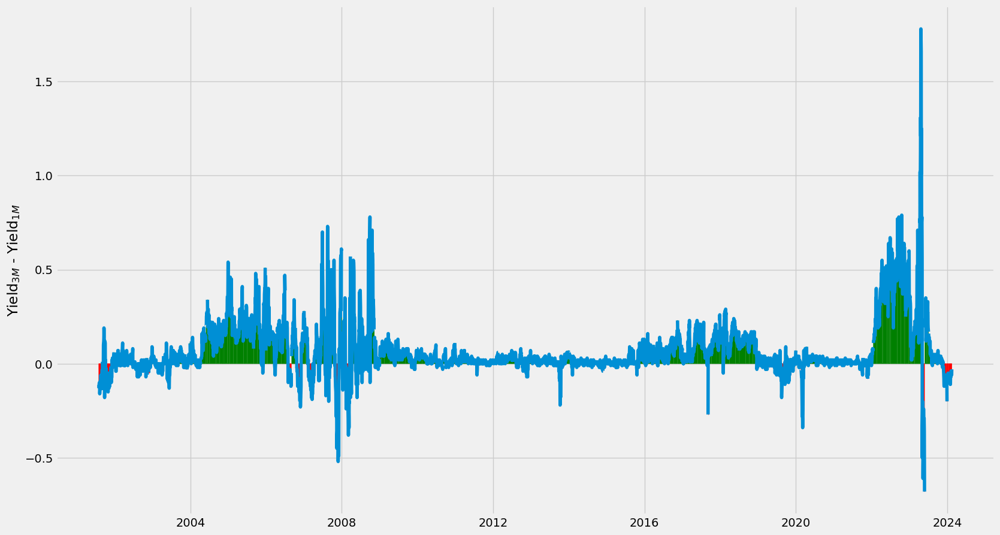

In [22]:
fig, ax = plt.subplots(figsize=(18,10.5))
diff = dffed['3M'] - dffed['1M']
plt.plot(dffed.index, diff)
plt.fill_between(dffed.index, 0, diff, where= diff < 0, color='red')
plt.fill_between(dffed.index, 0, diff, where= diff > 0, color='green')
plt.ylabel('Yield$_{3M}$ - Yield$_{1M}$')

US - 2 year vs. 1 month

Text(0, 0.5, 'Yield$_{2Y}$ - Yield$_{1M}$')

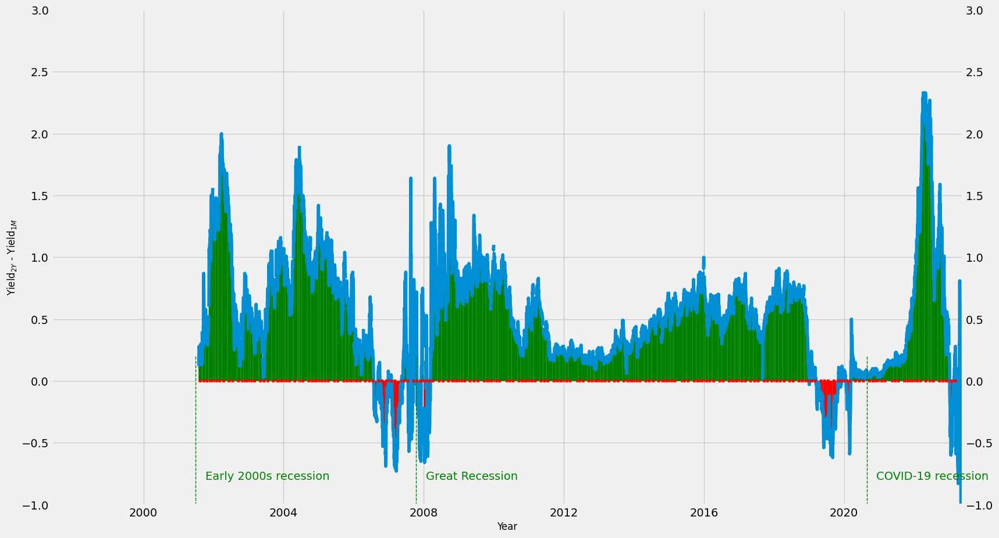

In [23]:
fig, ax = plt.subplots(figsize=(18,10.5))
diff = dffed['2Y'] - dffed['1M']
plt.plot(dffed.index, diff)
plt.fill_between(dffed.index, 0, diff, where= diff < 0, color='red')
plt.fill_between(dffed.index, 0, diff, where= diff > 0, color='green')
US_0=0*diff
ax.plot(US_0,linestyle='dotted', lw=3.5,color='red')
plt.axvline(x = 11500, color = 'g', linestyle = 'dashed', linewidth=1, ymax=0.3)
plt.axvline(x  = 13800, color = 'g', linestyle = 'dashed', linewidth=1, ymax=0.3)
plt.axvline(x  = 18500, color = 'g', linestyle = 'dashed', linewidth=1, ymax=0.3)
plt.text(11600, -0.8, 'Early 2000s recession', color='green')
plt.text(13900, -0.8, 'Great Recession', color='green')
plt.text(18600, -0.8, 'COVID-19 recession', color='green')

ax.set_xlim([10000, 19500])
ax.set_ylim([-1, 3]) 
ax.secondary_yaxis("right")
ax.set_xlabel(xlabel='Year', size=12)
ax.set_ylabel(ylabel='%', size=12)
plt.ylabel('Yield$_{2Y}$ - Yield$_{1M}$')

US - 30 year vs. 1 year

Text(0, 0.5, 'Yield$_{30Y}$ - Yield$_{1Y}$')

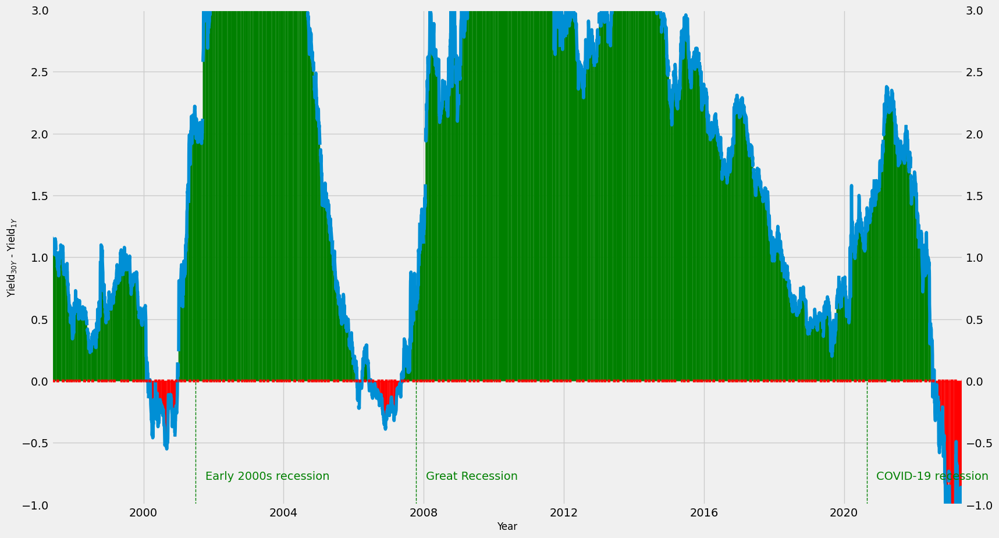

In [24]:
fig, ax = plt.subplots(figsize=(18,10.5))
diff = dffed['30Y'] - dffed['1Y']
plt.plot(dffed.index, diff)
plt.fill_between(dffed.index, 0, diff, where= diff < 0, color='red')
plt.fill_between(dffed.index, 0, diff, where= diff > 0, color='green')
US_0=0*diff
ax.plot(US_0,linestyle='dotted', lw=3.5,color='red')
plt.axvline(x = 11500, color = 'g', linestyle = 'dashed', linewidth=1, ymax=0.3)
plt.axvline(x  = 13800, color = 'g', linestyle = 'dashed', linewidth=1, ymax=0.3)
plt.axvline(x  = 18500, color = 'g', linestyle = 'dashed', linewidth=1, ymax=0.3)
plt.text(11600, -0.8, 'Early 2000s recession', color='green')
plt.text(13900, -0.8, 'Great Recession', color='green')
plt.text(18600, -0.8, 'COVID-19 recession', color='green')

ax.set_xlim([10000, 19500])
ax.set_ylim([-1, 3]) 
ax.secondary_yaxis("right")
ax.set_xlabel(xlabel='Year', size=12)
ax.set_ylabel(ylabel='%', size=12)
plt.ylabel('Yield$_{30Y}$ - Yield$_{1Y}$')

Forecasting

## Long-Short Term Memory Networks

In [25]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout
from keras import optimizers
from sklearn.preprocessing import MinMaxScaler

Using TensorFlow backend.

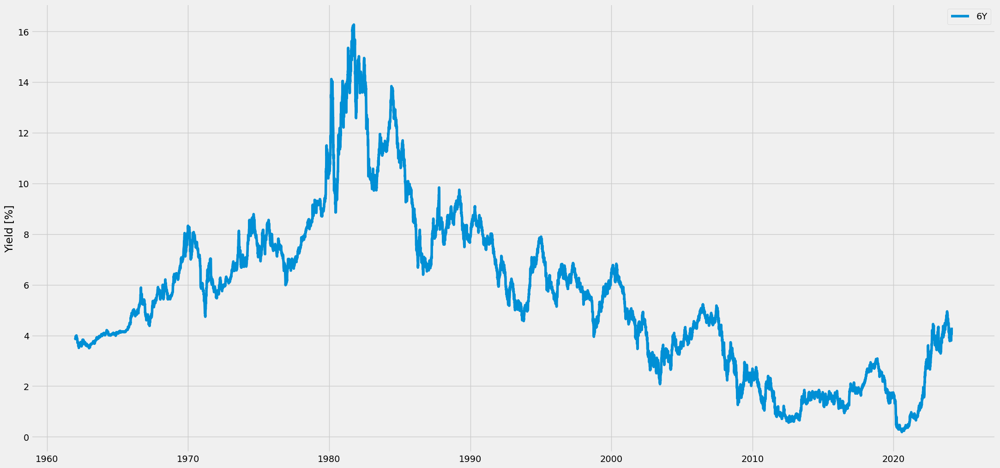

In [26]:
ts1 = dffed['5Y'].dropna()
ts1_idx = ts1.index

fig, ax = plt.subplots(1,1,figsize=(24, 12))
ax.plot(ts1, label = c )
ax.set_ylabel('Yield [%]')
ax.legend()

In [27]:
ts2 = ts1.values
scl = MinMaxScaler()
ts2 = ts2.reshape(ts2.shape[0],1)
ts2 = scl.fit_transform(ts2)

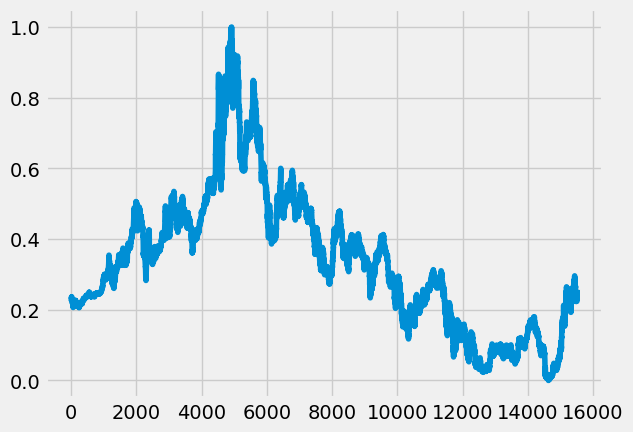

In [28]:
plt.plot(ts2)

In [65]:
def processData(data, lb):
    X, Y = [], []
    for i in range(len(data)-lb-1):
        X.append(data[i:(i+lb)])
        Y.append(data[i+lb])
    return np.array(X), np.array(Y)
X, y = processData(ts2, 6)
X_train, X_test = X[:int(X.shape[0]*0.78)], X[int(X.shape[0]*0.78):]
y_train, y_test = y[:int(y.shape[0]*0.78)], y[int(y.shape[0]*0.78):]
print('Checking that the split was performed correctly')
print("Shape of x_train:",X_train.shape)
print("Shape of x_test:",X_test.shape)
print("Shape of y_train:",y_train.shape)
print("Shape of y_test:",y_test.shape)

Checking that the split was performed correctly
Shape of x_train: (12096, 6, 1)
Shape of x_test: (3412, 6, 1)
Shape of y_train: (12096, 1)
Shape of y_test: (3412, 1)


In [66]:
from keras.optimizers import Adam

model = Sequential()
model.add(LSTM(32, input_shape=(6,1), return_sequences=True))
model.add(Dropout(0.5))
model.add(Dense(1))
adam = Adam(lr=0.001, clipnorm=1.)
model.compile(optimizer=adam, loss='mse')
X_train = X_train.reshape((X_train.shape[0], X_train.shape[1], 1))
X_test = X_test.reshape((X_test.shape[0], X_test.shape[1], 1))
history = model.fit(X_train, y_train, epochs=120, batch_size=50, verbose=1, validation_data=(X_test, y_test), shuffle=False)


Epoch 1/120
242/242 [==============================] - 3s 5ms/step - loss: 0.0174 - val_loss: 0.0069
Epoch 2/120
242/242 [==============================] - 1s 3ms/step - loss: 0.0074 - val_loss: 0.0067
Epoch 3/120
242/242 [==============================] - 1s 3ms/step - loss: 0.0062 - val_loss: 0.0063
Epoch 4/120
242/242 [==============================] - 1s 3ms/step - loss: 0.0055 - val_loss: 0.0057
Epoch 5/120
242/242 [==============================] - 1s 3ms/step - loss: 0.0048 - val_loss: 0.0051
Epoch 6/120
242/242 [==============================] - 1s 3ms/step - loss: 0.0043 - val_loss: 0.0045
Epoch 7/120
242/242 [==============================] - 1s 3ms/step - loss: 0.0039 - val_loss: 0.0039
Epoch 8/120
242/242 [==============================] - 1s 3ms/step - loss: 0.0034 - val_loss: 0.0033
Epoch 9/120
242/242 [==============================] - 1s 3ms/step - loss: 0.0030 - val_loss: 0.0027
Epoch 10/120
242/242 [==============================] - 1s 4ms/step - loss: 0.0026 - val_lo

Epoch 79/120
242/242 [==============================] - 1s 3ms/step - loss: 0.0011 - val_loss: 7.1313e-05
Epoch 80/120
242/242 [==============================] - 1s 3ms/step - loss: 0.0011 - val_loss: 6.3446e-05
Epoch 81/120
242/242 [==============================] - 1s 3ms/step - loss: 0.0011 - val_loss: 8.7461e-05
Epoch 82/120
242/242 [==============================] - 1s 3ms/step - loss: 0.0011 - val_loss: 7.1275e-05
Epoch 83/120
242/242 [==============================] - 1s 4ms/step - loss: 0.0011 - val_loss: 8.6054e-05
Epoch 84/120
242/242 [==============================] - 1s 3ms/step - loss: 0.0011 - val_loss: 6.3377e-05
Epoch 85/120
242/242 [==============================] - 1s 3ms/step - loss: 0.0010 - val_loss: 8.8973e-05
Epoch 86/120
242/242 [==============================] - 1s 3ms/step - loss: 0.0011 - val_loss: 7.9473e-05
Epoch 87/120
242/242 [==============================] - 1s 3ms/step - loss: 0.0011 - val_loss: 7.3070e-05
Epoch 88/120
242/242 [========================

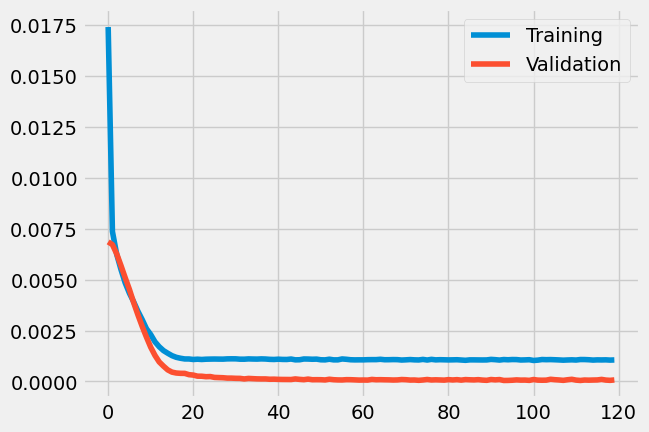

In [67]:
plt.plot(history.history['loss'], label = 'Training')
plt.plot(history.history['val_loss'], label = 'Validation')
plt.legend()

In [68]:
model64 = Sequential()
model64.add(LSTM(64, input_shape=(6,1)))
model64.add(Dropout(0.5))
model64.add(Dense(1))
adam = Adam(lr=0.001, clipnorm=1.)
model64.compile(optimizer=adam, loss='mse')
history64 = model64.fit(X_train, y_train, epochs=12, validation_data=(X_test, y_test), shuffle=False)

Epoch 1/12
378/378 [==============================] - 3s 4ms/step - loss: 0.0045 - val_loss: 0.0011
Epoch 2/12
378/378 [==============================] - 1s 3ms/step - loss: 0.0027 - val_loss: 0.0013
Epoch 3/12
378/378 [==============================] - 1s 3ms/step - loss: 0.0025 - val_loss: 0.0019
Epoch 4/12
378/378 [==============================] - 1s 3ms/step - loss: 0.0025 - val_loss: 0.0025
Epoch 5/12
378/378 [==============================] - 1s 3ms/step - loss: 0.0025 - val_loss: 0.0024
Epoch 6/12
378/378 [==============================] - 1s 3ms/step - loss: 0.0024 - val_loss: 0.0014
Epoch 7/12
378/378 [==============================] - 1s 3ms/step - loss: 0.0023 - val_loss: 6.4836e-04
Epoch 8/12
378/378 [==============================] - 1s 3ms/step - loss: 0.0020 - val_loss: 3.4950e-04
Epoch 9/12
378/378 [==============================] - 1s 3ms/step - loss: 0.0016 - val_loss: 2.4795e-04
Epoch 10/12
378/378 [==============================] - 1s 3ms/step - loss: 0.0015 - val_

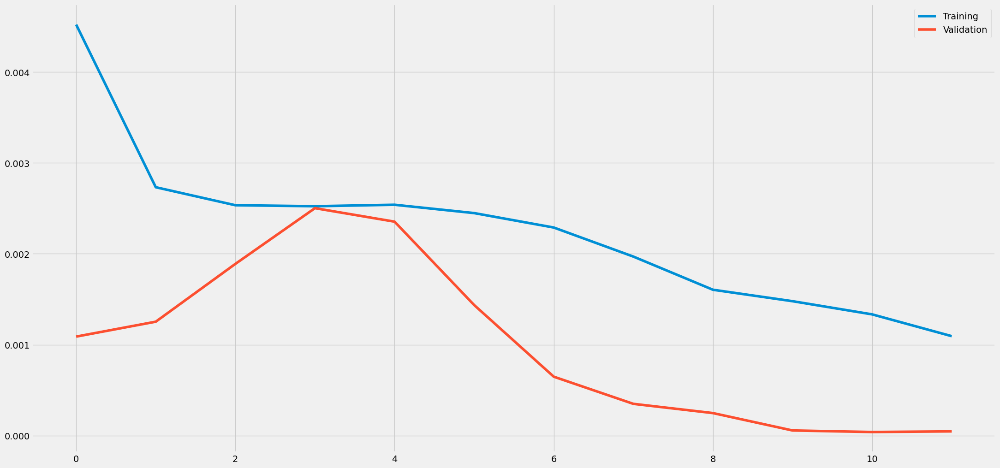

In [70]:
fig, ax = plt.subplots(1,1,figsize=(24, 12))
ax.plot(history64.history['loss'], label = 'Training')
ax.plot(history64.history['val_loss'], label = 'Validation')
ax.legend()

107/107 [==============================] - 0s 2ms/step


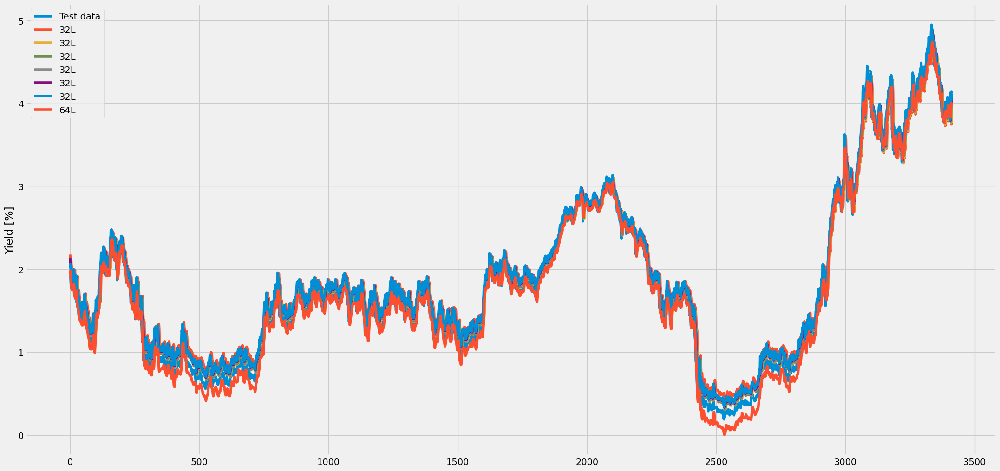

In [71]:
Xt32 = model.predict(X_test)
Xt64 = model64.predict(X_test)

# Chỉ trích xuất giá trị dự đoán từ mảng ba chiều thành mảng hai chiều
Xt32_2d = Xt32[:, :, 0]
Xt64_2d = Xt64[:, 0]

fig, ax = plt.subplots(1, 1, figsize=(24, 12))
ax.plot(scl.inverse_transform(y_test.reshape(-1, 1)), label='Test data')
ax.plot(scl.inverse_transform(Xt32_2d), label='32L')
ax.plot(scl.inverse_transform(Xt64_2d.reshape(-1, 1)), label='64L')  # Reshape Xt64_2d thành mảng hai chiều
ax.set_ylabel('Yield [%]')
ax.legend()


In [72]:
import time

import pandas as pd
import plotly.express as px
import datetime
import matplotlib.pyplot as plt
import yfinance as yf
import numpy as np
yield_curves = pd.DataFrame()
yield_curves_diff = pd.DataFrame()

last_five_years = [str(int(datetime.date.today().year) - i) for i in range(0, 6)]
this_year = last_five_years[0]

for i in range(len(last_five_years)):
    ustd_url = "https://home.treasury.gov/resource-center/data-chart-center/interest-rates/daily-treasury-rates.csv/"+last_five_years[i]+"/all?type=daily_treasury_yield_curve&field_tdr_date_value="+last_five_years[i]+"&page&_format=csv"
    yield_curve_df = pd.read_csv(ustd_url)
    if('4 Mo' in yield_curve_df.columns):
        yield_curve_df = yield_curve_df.drop('4 Mo',axis=1)
    if i == 0: # Save this year data
        yield_curve_y0_df = yield_curve_df
        
    yc_1 = yield_curve_df.copy(deep=True)
    yc_1['Date'] = pd.to_datetime(yc_1['Date'])
    yc_1 = yc_1.set_index('Date')
    
    for j in range(1,len(yc_1.columns)): 
        yc_1.iloc[1:,j] = pd.to_numeric(yc_1.iloc[1:,j],errors='coerce') 
        
    yield_curves = pd.concat([yield_curves,yc_1])
    # yield_curves = y.groupby(level=0)
    
    yc_1_diff = round(yc_1.pct_change(periods=1)*100,3)
    yc_1_diff.dropna()
    
    yield_curves_diff = pd.concat([yield_curves_diff,yc_1_diff])
    # yield_curves_diff = yd.groupby()
    
    # print(yield_curves)
    print(".", end='')
    time.sleep(2)

......

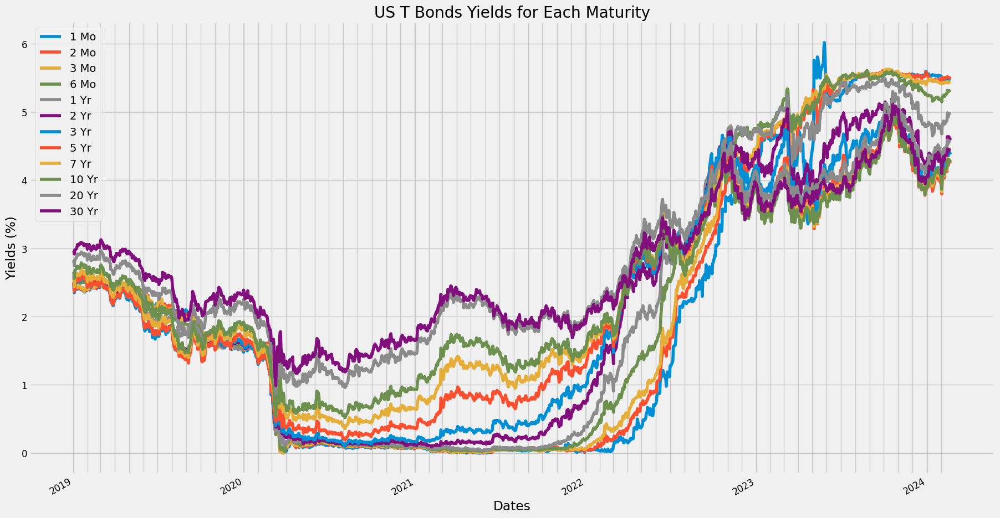

In [73]:
ax = yield_curves.plot(figsize=(20,12),grid=True,xlabel='Dates',ylabel='Yields (%)',
                  title='US T Bonds Yields for Each Maturity',fontsize=12)
xtick = pd.date_range( start=yield_curves.index.min( ), end=yield_curves.index.max( ), freq='M' )
ax.set_xticks( xtick, minor=True )
ax.grid('on', which='minor', axis='x' )

In [74]:
yield_curves.iloc[:8,4:]

,1 Yr,2 Yr,3 Yr,5 Yr,7 Yr,10 Yr,20 Yr,30 Yr
Date,,,,,,,,
2024-02-20,4.97,4.59,4.38,4.25,4.28,4.27,4.56,4.44
2024-02-16,4.98,4.64,4.43,4.29,4.31,4.30,4.58,4.45
2024-02-15,4.93,4.56,4.36,4.22,4.25,4.24,4.54,4.42
2024-02-14,4.94,4.56,4.38,4.25,4.27,4.27,4.57,4.45
2024-02-13,4.99,4.64,4.44,4.31,4.33,4.31,4.59,4.46
2024-02-12,4.87,4.46,4.25,4.13,4.16,4.17,4.48,4.37
2024-02-09,4.86,4.48,4.25,4.14,4.17,4.17,4.48,4.37
2024-02-08,4.83,4.46,4.22,4.12,4.15,4.15,4.47,4.36


In [75]:
def find_crossings(series1, series2):
    # Find the crossings of Series 1 and Series 2
    crossing_series = pd.Series([0] * len(series1), index=series1.index)
    for i in range(1, len(series1)):
        if ((series1.iloc[i-1] < series2.iloc[i-1]) and (series1.iloc[i] >= series2.iloc[i])):
            crossing_series.iloc[i] = 1
        elif ((series1.iloc[i-1] >= series2.iloc[i-1]) and (series1.iloc[i] < series2.iloc[i])):
            crossing_series.iloc[i] = -1

    # print(series2)
    cross_up = []
    cross_down = []
    for i in series1.index: 
        if crossing_series.loc[i] == 1 : 
            cross_up.append(series1.loc[i])
            cross_down.append(np.nan)
        elif crossing_series.loc[i] == -1:
            cross_down.append(series1.loc[i])
            cross_up.append(np.nan)
        else:
            cross_down.append(np.nan)
            cross_up.append(np.nan)
        

    return crossing_series,cross_up,cross_down

def plot_crossing_series(series1,series2,crossed_up,crossed_down):
    ax = series1.plot(figsize=(15,6))
    ax.grid(True)
    series2.plot(ax=ax)
    
    # Plot the corressing up and down
    ax.plot(series1.index,crossed_up,marker='^',color='green', 
                markersize = 12, linewidth = 0, label = f'{series1.name} Crossed Up')
    ax.plot(series1.index,crossed_down,marker='v',color='red', 
                    markersize = 12, linewidth = 0, label = f'{series1.name} Crossed Down')
    ax.legend()
    ax.grid(which='both')

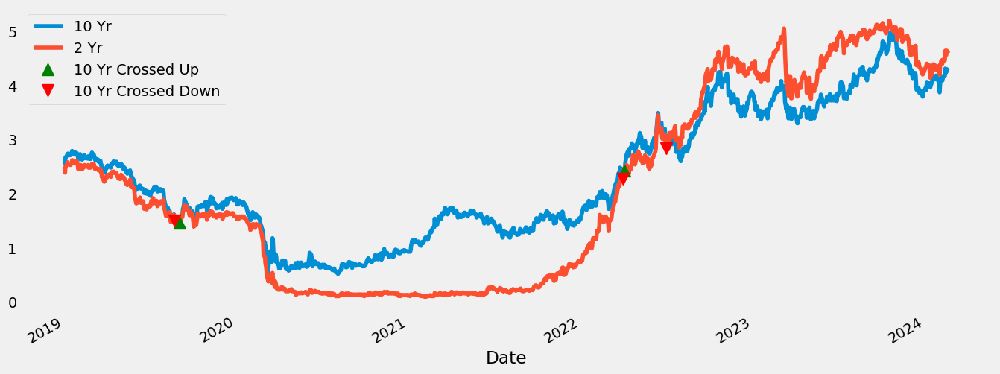

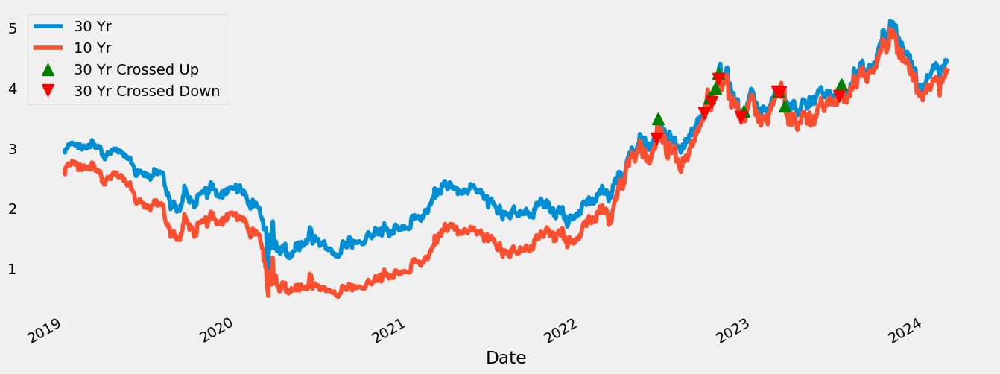

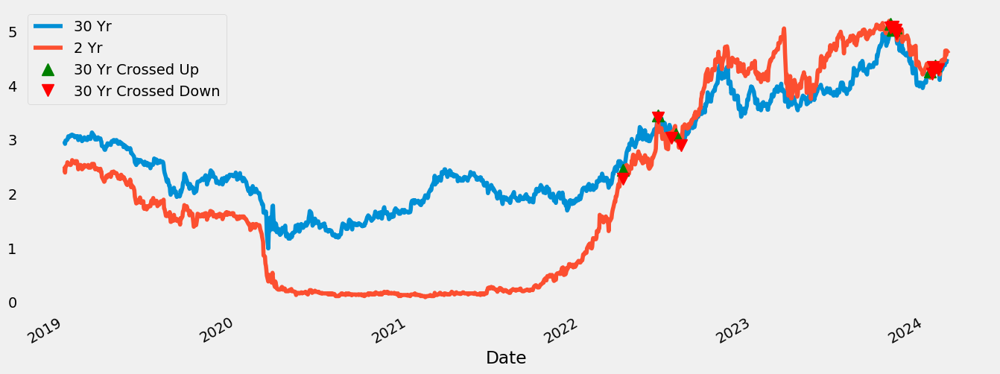

In [76]:
crossing_series, crossed_up, crossed_down=find_crossings(yield_curves['2 Yr'],yield_curves['10 Yr'])

plot_crossing_series(series2=yield_curves['2 Yr'],series1=yield_curves['10 Yr'],
                     crossed_up=crossed_up,crossed_down=crossed_down)
plt.show()

crossing_series, crossed_up, crossed_down=find_crossings(yield_curves['10 Yr'],yield_curves['30 Yr'])

plot_crossing_series(series2=yield_curves['10 Yr'],series1=yield_curves['30 Yr'],
                     crossed_up=crossed_up,crossed_down=crossed_down)
plt.show()


crossing_series, crossed_up, crossed_down=find_crossings(yield_curves['2 Yr'],yield_curves['30 Yr'])

plot_crossing_series(series2=yield_curves['2 Yr'],series1=yield_curves['30 Yr'],
                     crossed_up=crossed_up,crossed_down=crossed_down)
plt.show()

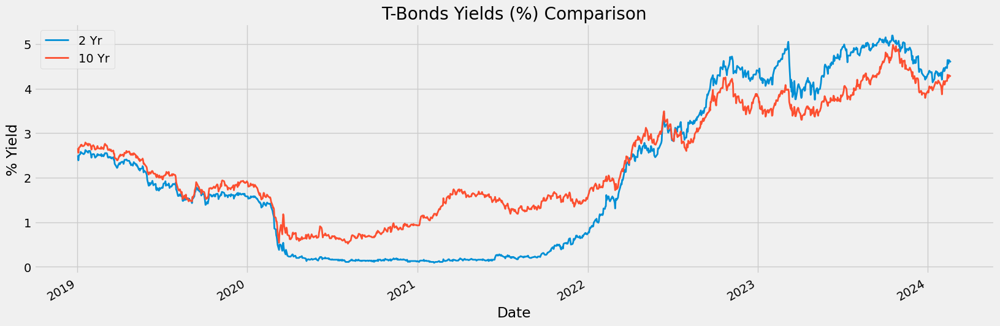

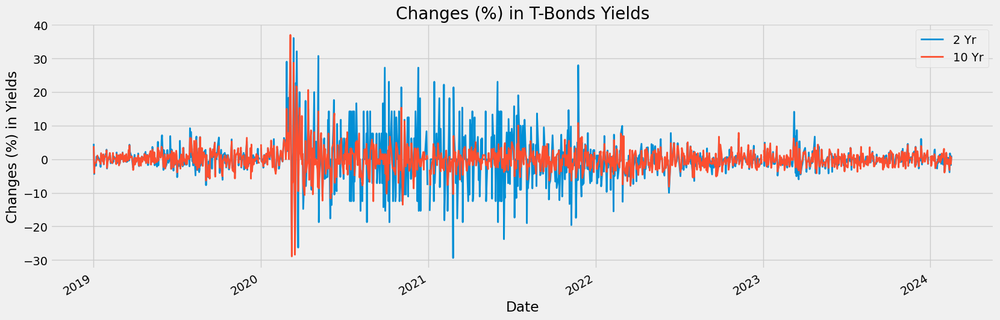

In [77]:
# Plot all
yield_curves[['2 Yr','10 Yr']].plot(figsize=(18,6),grid=True,
                            lw=2,xlabel='Date',ylabel='% Yield',
                            title="T-Bonds Yields (%) Comparison")
yield_curves_diff[['2 Yr','10 Yr']].plot(figsize=(18,6),grid=True,
                                 lw=2,xlabel='Date',ylabel='Changes (%) in Yields',
                                 title="Changes (%) in T-Bonds Yields")

plt.show()

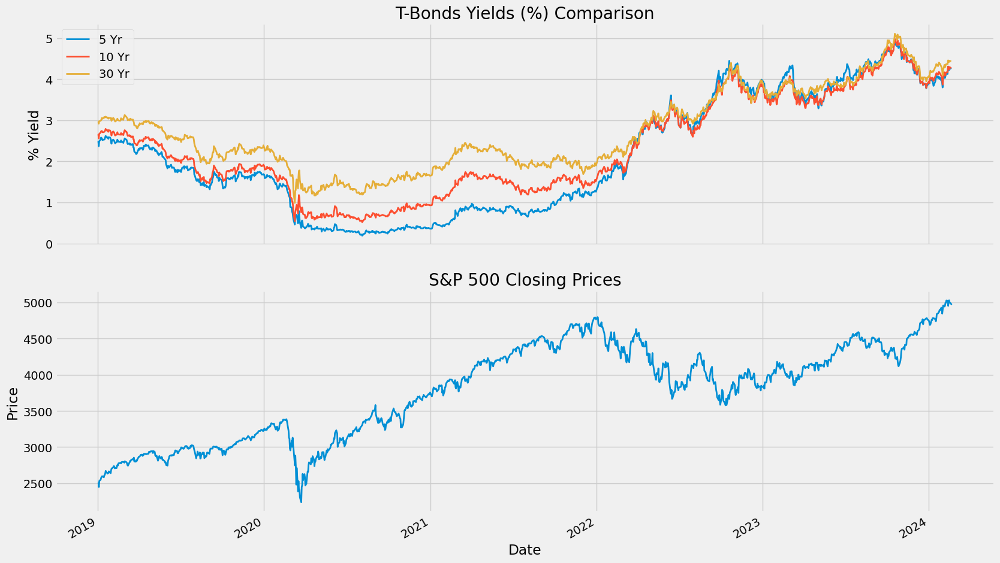

In [78]:
fig, ax = plt.subplots(2,1,figsize=(18,12),sharex=True)
yield_curves[['5 Yr','10 Yr','30 Yr']].plot(ax=ax[0],grid=True,
                            lw=2,xlabel='Date',ylabel='% Yield',
                            title="T-Bonds Yields (%) Comparison")

start_date = yield_curves.index[-1].strftime("%Y-%m-%d")
df_sp500 = yf.Ticker('^GSPC').history(start=start_date,interval='1d')['Close']


df_sp500.plot(ax=ax[1],grid=True,
                            lw=2,xlabel='Date',ylabel='Price',
                            title="S&P 500 Closing Prices")
plt.show()

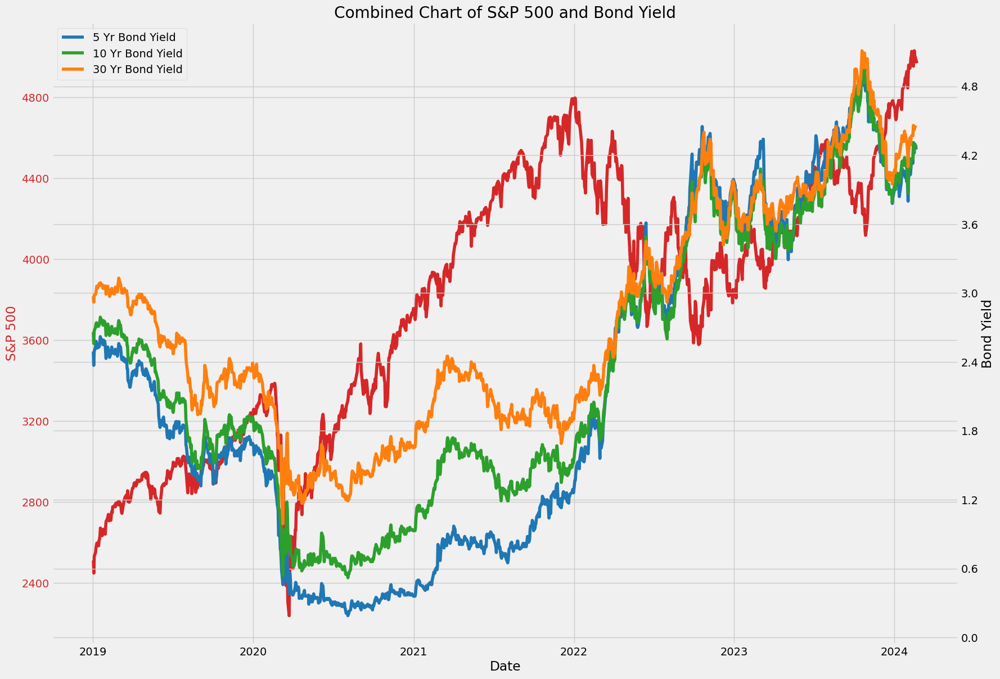

In [79]:
import matplotlib.ticker as ticker

fig, ax1 = plt.subplots(figsize=(18,12))

color = 'tab:red'
ax1.set_xlabel('Date')
ax1.set_ylabel('S&P 500', color=color)
ax1.plot(df_sp500.index, df_sp500, color=color, label='S&P 500')
ax1.tick_params(axis='y', labelcolor=color)
ax1.xaxis.set_major_locator(mdates.YearLocator())
ax1.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
ax1.yaxis.set_major_locator(ticker.MaxNLocator(10))

ax2 = ax1.twinx()  
ax2.set_ylabel('Bond Yield')  
ax2.plot(yield_curves.index, yield_curves['5 Yr'], color='tab:blue', label='5 Yr Bond Yield')
ax2.plot(yield_curves.index, yield_curves['10 Yr'], color='tab:green', label='10 Yr Bond Yield')
ax2.plot(yield_curves.index, yield_curves['30 Yr'], color='tab:orange', label='30 Yr Bond Yield')
ax2.tick_params(axis='y')
ax2.yaxis.set_major_locator(ticker.MaxNLocator(10))

fig.tight_layout()  
plt.title("Combined Chart of S&P 500 and Bond Yield")
plt.grid(True)
plt.legend()
plt.show()


S&P 500 Correlation with Bond Yields :
   Maturities  Correlations
0        1 Mo      0.240392
1        2 Mo      0.248832
2        3 Mo      0.256002
3        6 Mo      0.267179
4        1 Yr      0.282548
5        2 Yr      0.312324
6        3 Yr      0.337305
7        5 Yr      0.382382
8        7 Yr      0.410052
9       10 Yr      0.421445
10      20 Yr      0.469399
11      30 Yr      0.414506


<Axes: title={'center': 'S&P 500 Prices Correlation with T Bond Yields'}, xlabel='T Bonds by Maturity', ylabel='Corr with S&P 500'>

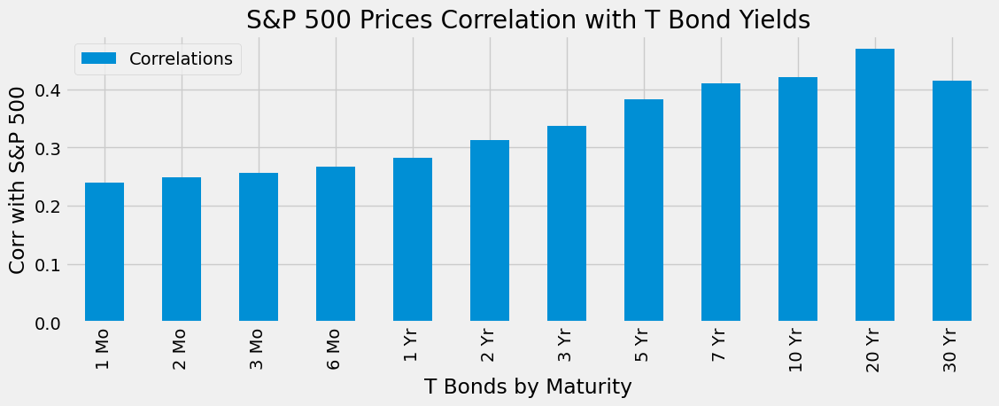

In [80]:
corr_with_bond = yield_curves.tz_localize('America/New_York').corrwith(df_sp500)
# corr_with_bond.values
corr_with_bond_df = pd.DataFrame({'Maturities':corr_with_bond.index,'Correlations':corr_with_bond.values})
print("S&P 500 Correlation with Bond Yields :")
print(corr_with_bond_df)
corr_with_bond_df.plot.bar(x='Maturities',y='Correlations',figsize=(12,4),
                           title="S&P 500 Prices Correlation with T Bond Yields",ylabel="Corr with S&P 500",
                           xlabel='T Bonds by Maturity',grid=True)

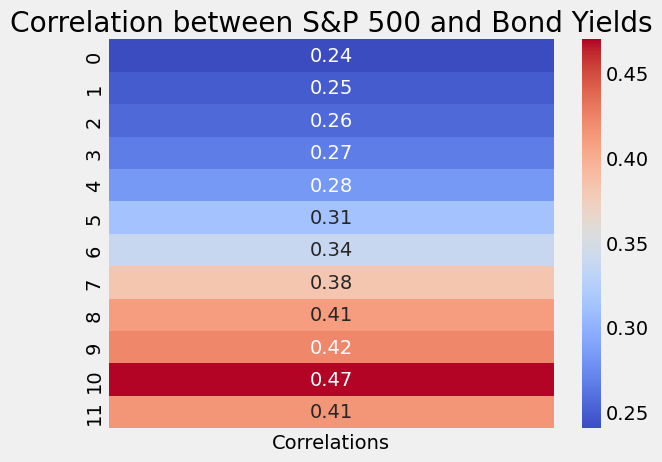

In [81]:
import seaborn as sns

# Create a new DataFrame with only 'Correlations' column
corr_with_bond_df_numeric = pd.DataFrame({'Correlations':corr_with_bond.values})

# Generate a heatmap
sns.heatmap(corr_with_bond_df_numeric, annot=True, cmap='coolwarm')
plt.title("Correlation between S&P 500 and Bond Yields")
plt.show()


Re-Formating and Cleaning the Data into a DataFrame

In [82]:
yield_curve_df2 = yield_curve_y0_df.reset_index()
yield_curve_df2 = yield_curve_df2.T
yield_curve_df2 = yield_curve_df2.reset_index()

yield_curve_df2 = yield_curve_df2.drop([0])
yield_curve_df2.iloc[0,0] = 'Maturity'
cols = [str(x) for x in yield_curve_df2.iloc[0,:]]

In [83]:
yield_curve_df2.columns = cols
yield_curve_df2 = yield_curve_df2.iloc[1:,:].copy()
yield_curve_df2.reset_index(inplace=True)
yield_curve_df2.drop(['index'],axis=1,inplace=True)
yield_curve_df2 = yield_curve_df2.set_index('Maturity')
yield_curve_df2

,02/20/2024,02/16/2024,02/15/2024,02/14/2024,02/13/2024,02/12/2024,02/09/2024,02/08/2024,02/07/2024,02/06/2024,...,01/16/2024,01/12/2024,01/11/2024,01/10/2024,01/09/2024,01/08/2024,01/05/2024,01/04/2024,01/03/2024,01/02/2024
Maturity,,,,,,,,,,,,,,,,,,,,,
1 Mo,5.49,5.48,5.49,5.48,5.48,5.49,5.49,5.49,5.47,5.48,...,5.54,5.55,5.54,5.53,5.53,5.54,5.54,5.56,5.54,5.55
2 Mo,5.49,5.51,5.51,5.51,5.52,5.51,5.51,5.51,5.49,5.5,...,5.47,5.47,5.47,5.46,5.46,5.48,5.48,5.48,5.54,5.54
3 Mo,5.44,5.44,5.43,5.43,5.45,5.43,5.44,5.44,5.43,5.44,...,5.45,5.45,5.46,5.46,5.47,5.49,5.47,5.48,5.48,5.46
6 Mo,5.32,5.31,5.3,5.31,5.32,5.27,5.26,5.24,5.23,5.23,...,5.18,5.16,5.22,5.23,5.24,5.24,5.24,5.25,5.25,5.24
1 Yr,4.97,4.98,4.93,4.94,4.99,4.87,4.86,4.83,4.83,4.82,...,4.7,4.65,4.75,4.82,4.82,4.82,4.84,4.85,4.81,4.8
2 Yr,4.59,4.64,4.56,4.56,4.64,4.46,4.48,4.46,4.41,4.39,...,4.22,4.14,4.26,4.37,4.36,4.36,4.4,4.38,4.33,4.33
3 Yr,4.38,4.43,4.36,4.38,4.44,4.25,4.25,4.22,4.16,4.14,...,4.02,3.92,4.02,4.1,4.09,4.11,4.17,4.14,4.07,4.09
5 Yr,4.25,4.29,4.22,4.25,4.31,4.13,4.14,4.12,4.06,4.03,...,3.95,3.84,3.9,3.99,3.97,3.97,4.02,3.97,3.9,3.93
7 Yr,4.28,4.31,4.25,4.27,4.33,4.16,4.17,4.15,4.09,4.07,...,4.01,3.91,3.95,4.01,4.0,3.99,4.04,3.99,3.92,3.95


Plot the Most Recent Yield Curves

In [84]:
longest_n_maturities = 8   # For ALL maturities set = len(yield_curve_df2)
last_n_days = 5            # For ALL days in the data set = -1
fig = px.line(yield_curve_df2.iloc[-longest_n_maturities:,:last_n_days],markers=True)

fig.update_layout(
    width=1200,
    height=600,
   title="US Treasury Bonds Yield Curve",
   xaxis_title='Bond Maturity',
   yaxis_title='Interest Rate %',
   legend_title="Curve Date",
   font=dict(
      family="Arial",
      size=20,
      color="blue"
   )
)
fig.show()

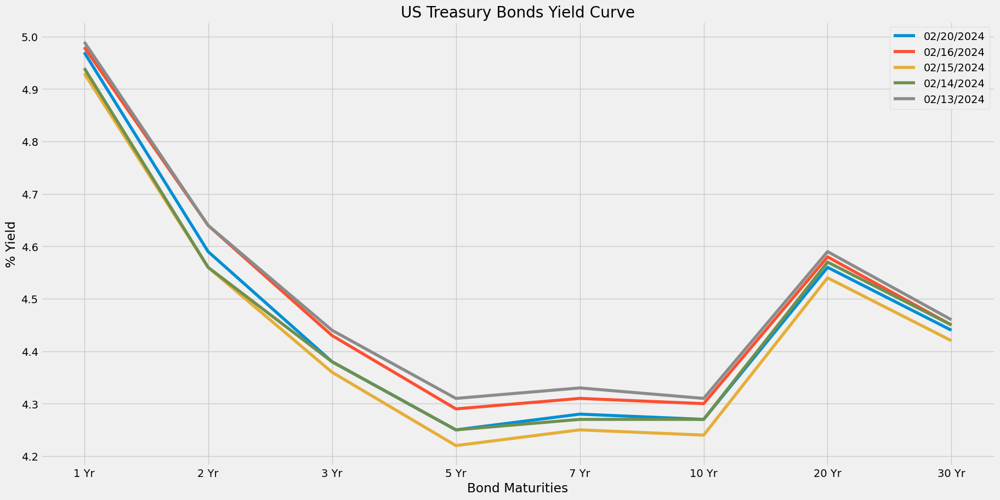

In [85]:
yield_curve_df2.iloc[-8:,:5].plot(figsize=(20,10),title="US Treasury Bonds Yield Curve",ylabel='% Yield',
                     xlabel='Bond Maturities',grid=True)
plt.show()

Text(0.5, 1.0, 'United States Term Structure of Interest Rate 1955-Present')

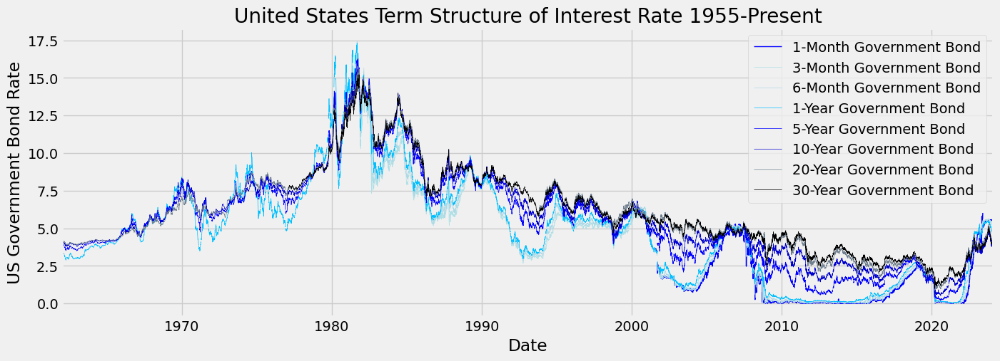

In [86]:
# 2D Visualization

%matplotlib inline
dffed['1M'].plot(figsize=(15,5), lw=1, color="blue", label='1-Month Government Bond')
dffed['3M'].plot( lw=0.5, color="powderblue",label='3-Month Government Bond')
dffed['6M'].plot( lw=0.5, color="lightblue",label='6-Month Government Bond')
dffed['1Y'].plot( lw=0.5, color="deepskyblue",label='1-Year Government Bond')
dffed['5Y'].plot( lw=0.5, color="blue",label='5-Year Government Bond')
dffed['10Y'].plot( lw=0.5, color="mediumblue",label='10-Year Government Bond')
dffed['20Y'].plot( lw=0.5, color="slategrey", label='20-Year Government Bond')
dffed['30Y'].plot( lw=0.5, color="black", grid=True,label='30-Year Government Bond')
plt.legend()
plt.xlabel("Date")
plt.ylabel("US Government Bond Rate")
plt.title("United States Term Structure of Interest Rate 1955-Present")

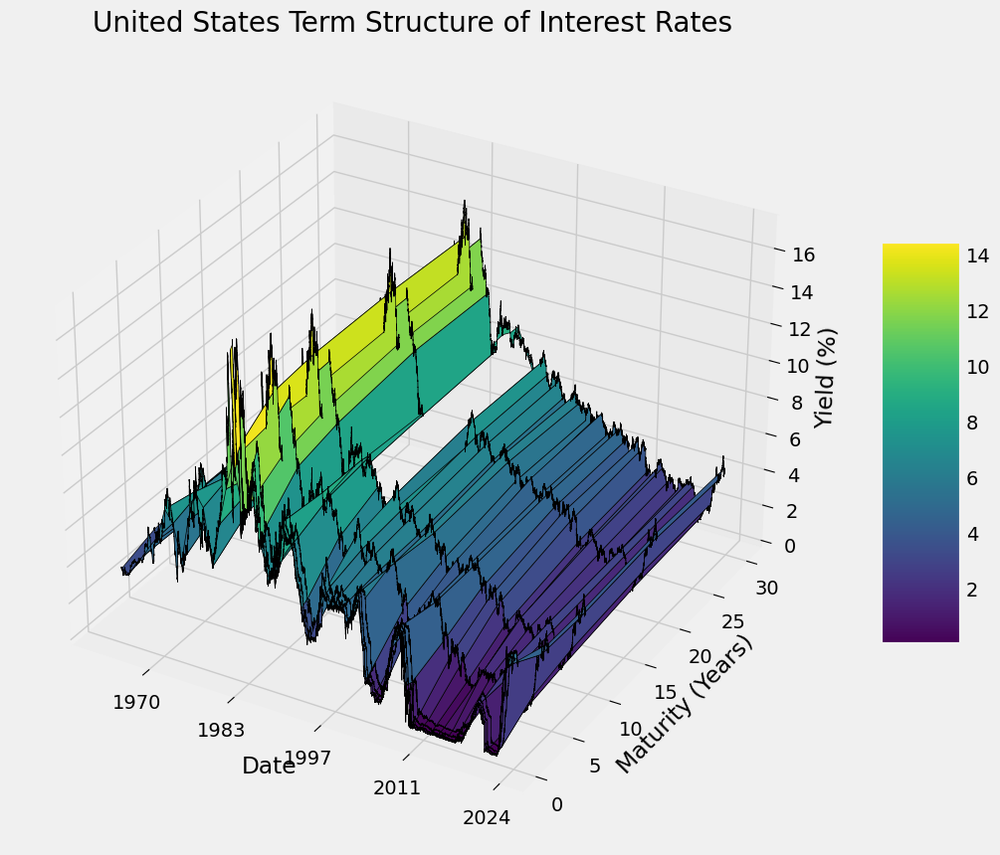

In [87]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.dates as mdates

# Convert dates to numbers
dates_num = mdates.date2num(dffed.index.to_pydatetime())

# Create a 2D array of dates and maturities
x_data, y_data = np.meshgrid(dates_num, [1/12, 3/12, 6/12, 1, 5, 10, 20, 30])

# Create a 2D array of yields
z_data = dffed[['1M', '3M', '6M', '1Y', '5Y', '10Y', '20Y', '30Y']].values.T

# Create the 3D plot
fig = plt.figure(figsize=(15, 10))
ax = fig.add_subplot(111, projection='3d')
surf = ax.plot_surface(x_data, y_data, z_data, cmap='viridis', edgecolor='k')

# Format the x-axis as dates
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))

# Set labels
ax.set_xlabel('Date')
ax.set_ylabel('Maturity (Years)')
ax.set_zlabel('Yield (%)')
ax.set_title('United States Term Structure of Interest Rates')

# Add a color bar
fig.colorbar(surf, shrink=0.5, aspect=5)

plt.show()


In [88]:
plt.savefig('my_pgf_plot.jpeg')

<Figure size 640x480 with 0 Axes>

In [89]:
ffr = pd.read_csv('DFF.csv', parse_dates=['DATE'], index_col='DATE')
print(ffr.tail(10))


            EFFR
DATE            
2024-02-05  5.33
2024-02-06  5.33
2024-02-07  5.33
2024-02-08  5.33
2024-02-09  5.33
2024-02-10  5.33
2024-02-11  5.33
2024-02-12  5.33
2024-02-13  5.33
2024-02-14  5.33


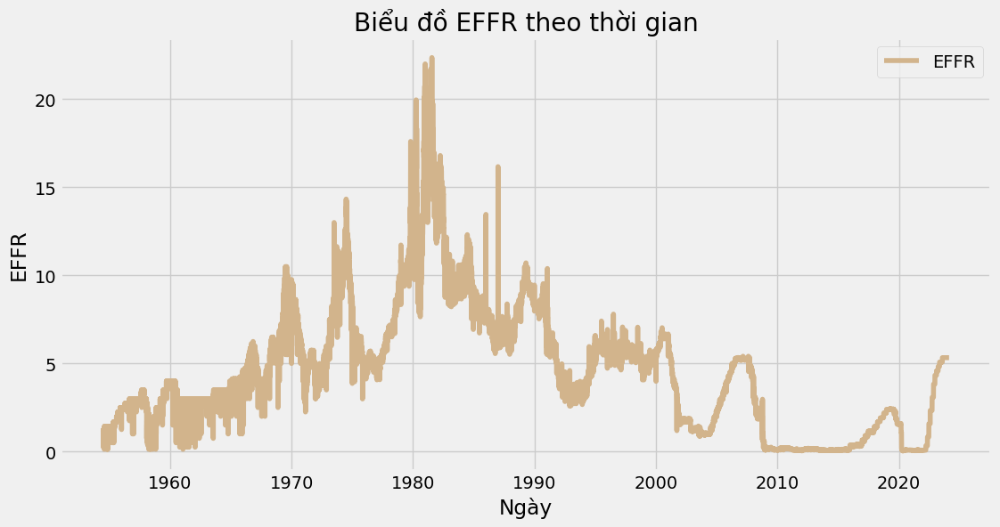

In [90]:
import matplotlib.pyplot as plt

# Vẽ biểu đồ cho EFFR
plt.figure(figsize=(12,6))
plt.plot(ffr.index, ffr['EFFR'], label='EFFR', color='tan')
plt.title('Biểu đồ EFFR theo thời gian')
plt.xlabel('Ngày')
plt.ylabel('EFFR')
plt.legend()
plt.show()




In [91]:
import plotly.graph_objects as go

# Chọn những cột dữ liệu cần thiết từ dataframe 'dffed'
columns_to_plot = ['1M', '3M', '6M', '1Y', '2Y', '3Y', '5Y', '7Y', '10Y', '20Y', '30Y']
dffed_filtered = dffed[columns_to_plot]

# Tạo một đối tượng Figure
fig = go.Figure()

# Thêm đường biểu đồ cho EFFR
fig.add_trace(go.Scatter(x=ffr.index, y=ffr['EFFR'], mode='lines', name='EFFR'))

# Thêm đường biểu đồ cho bond yield cho các kì hạn
for column in dffed_filtered.columns:
    fig.add_trace(go.Scatter(x=dffed_filtered.index, y=dffed_filtered[column], mode='lines', name=column))

# Cập nhật layout
fig.update_layout(
    title='Biểu đồ EFFR và Bond Yield theo thời gian',
    xaxis_title='Time',
    yaxis_title='Yields',
    hovermode='x unified'  # Cho phép hiển thị tooltip cho tất cả các đường biểu đồ tại một điểm trên trục x
)

# Hiển thị biểu đồ
fig.show()


In [92]:
import pandas as pd

# Chuyển đổi cột 'DATE' sang định dạng ngày tháng trong DataFrame 'ffr'
#ffr['DATE'] = pd.to_datetime(ffr['DATE'])


# Merge hai DataFrame dựa trên cột 'DATE' của DataFrame 'ffr' và cột 'Date' của DataFrame 'dffed'
financials = pd.merge(dffed, ffr, left_index=True, right_on='DATE', how='inner')

# Thêm một cột thời gian mới cho DataFrame 'financials'
#financials['Time'] = range(len(financials))

# In ra vài dòng đầu của DataFrame mới
print(financials.tail(5))


              1M    3M    6M    1Y    2Y    3Y    5Y    7Y   10Y   20Y   30Y  \
DATE                                                                           
2024-02-07  5.47  5.43  5.23  4.83  4.41  4.16  4.06  4.09  4.09  4.41  4.31   
2024-02-08  5.49  5.44  5.24  4.83  4.46  4.22  4.12  4.15  4.15  4.47  4.36   
2024-02-09  5.49  5.44  5.26  4.86  4.48  4.25  4.14  4.17  4.17  4.48  4.37   
2024-02-12  5.49  5.43  5.27  4.87  4.46  4.25  4.13  4.16  4.17  4.48  4.37   
2024-02-13  5.48  5.45  5.32  4.99  4.64  4.44  4.31  4.33  4.31  4.59  4.46   

            EFFR  
DATE              
2024-02-07  5.33  
2024-02-08  5.33  
2024-02-09  5.33  
2024-02-12  5.33  
2024-02-13  5.33  


In [93]:
#Find null values
null_rates = pd.DataFrame(round(financials.isnull().sum()*100/financials.shape[0],2), columns = ['null_count'])
null_rates[null_rates['null_count']>0]

,null_count
1M,65.22
3M,34.51
6M,34.51
1Y,4.26
2Y,26.43
3Y,4.26
5Y,4.26
7Y,15.80
10Y,4.26
20Y,14.69


In [94]:
#We fill in the missing data with the forward filling so as not to leak data
financials = financials.fillna(method = 'ffill')
#Backfilling to catch the end points
financials = financials.fillna(method = 'bfill')

#Checking again
null_rates = pd.DataFrame(round(financials.isnull().sum()*100/financials.shape[0],2), columns = ['null_count'])
null_rates[null_rates['null_count']>0]

,null_count


<Axes: xlabel='3M', ylabel='Count'>

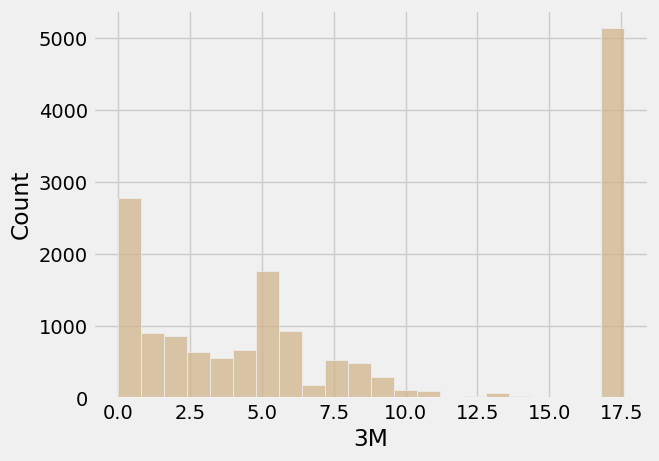

In [95]:
#The 3 month treasury bill is generally regarded as the risk free rate by investors
#Distribution:
import seaborn as sb
sb.histplot(data = financials['3M'], binwidth = 0.8, color = 'tan')

<Axes: xlabel='10Y', ylabel='Count'>

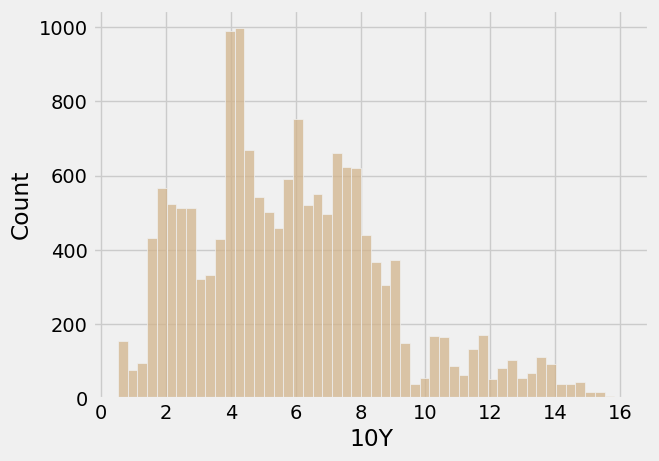

In [96]:
#The 10 year treasury bill is regarded as a medium term bond
#Distribution:
sb.histplot(data = financials['10Y'], binwidth = 0.3, color = 'tan')

<Axes: xlabel='DATE'>

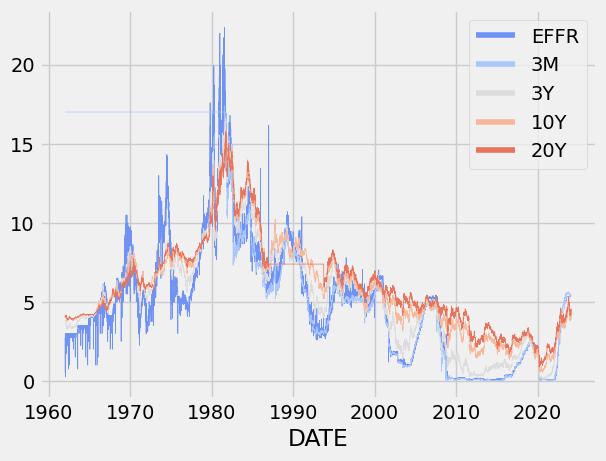

In [97]:
sb.lineplot(data = financials[['EFFR', '3M', '3Y', '10Y', '20Y']], dashes = False, linewidth = 0.5, palette = 'coolwarm')

<Axes: xlabel='EFFR', ylabel='3M'>

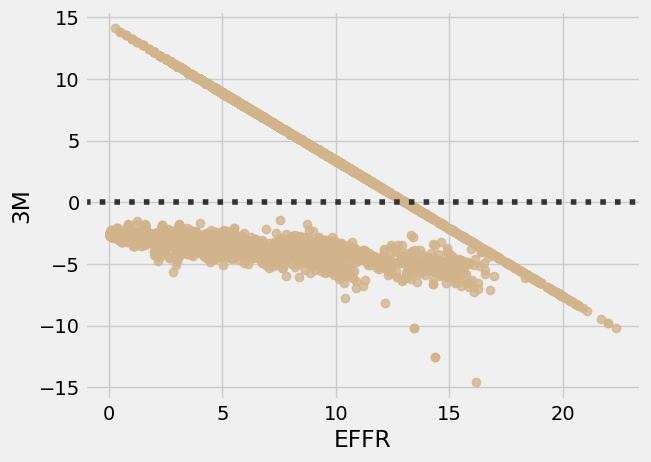

In [98]:
sb.residplot(data = financials, x = 'EFFR', y = '3M', color = 'tan')

The EFFR is the effective federal funds rate, or the rate that banks charge each other to do overnight lending. Due to the short duration, the federal funds rate is essentially risk free. Similarly, the 3 month bond is very low risk since the borrower is the US government, and the duration is very short.

The 3 month bond may be different than the federal funds rate due to a variety of factors. One factor is risk expectations. If investors expect the interest rate (EFFR) to rise in the future (within the maturity of their bond), they will demand a higher yield. Holding all else equal, we would then expect any residuals from the regression model to reflect these expectations. Therefore, points above the line reflect investors anticipating a raise in interest rates, while points below the line reflect investors anticipating a fall in interest rates.

Interest rates and the EFFR only changes with FOMC meetings 8 times a year, or every 6-7 weeks. This is in comparison to a 3 month bonds (12 weeks), which will always include at least 1 FOMC meeting within its maturity. The risk that the Fed will raise interest rates and lower the value of your bond is called interest rate risk.

Looking back at the histogram that we generated earlier for the distribution of 3 month bond yields, a strong right skew is present. The higher the rate, the lower the probability (assuming everything else is the same). Therefore, investors know that high rates are unlikely to persist, and do not demand the EFFR when it is very high (regression to the mean).

Inflation

In [ ]:

# Importing CPI data
cpi = pd.read_csv("CORE_CPI_US.csv")

# Change column names on cpi
cpi.columns = ['DATE', 'CORECPI']

# Convert 'DATE' column to datetime format
cpi['DATE'] = pd.to_datetime(cpi['DATE'])

# Merge the filtered data frames
financials = pd.merge(cpi, financials, on='DATE', how='right')

# Print the last 5 rows of the merged DataFrame
print(financials.tail(10))


In [ ]:
# Drop columns 'CORECPI_x' and 'CORECPI_y' from financials DataFrame
financials.drop(['CORECPI_x', 'CORECPI_y'], axis=1, inplace=True)


In [ ]:
#We fill in the missing data with the forward filling so as not to leak data
financials['CORECPI'] = financials['CORECPI'].fillna(method = 'ffill')
#Part of the data needs to be backfilled -- it's ok since its only a bit
financials['CORECPI'] = financials['CORECPI'].fillna(method = 'bfill')

#Checking again
null_rates = pd.DataFrame(round(financials.isnull().sum()*100/financials.shape[0],2), columns = ['null_count'])
null_rates[null_rates['null_count']>0]

In [ ]:
sb.lineplot(data = financials, x = 'DATE', y = 'CORECPI', color='tan')


<Axes: xlabel='DATE', ylabel='CPI_derivative'>

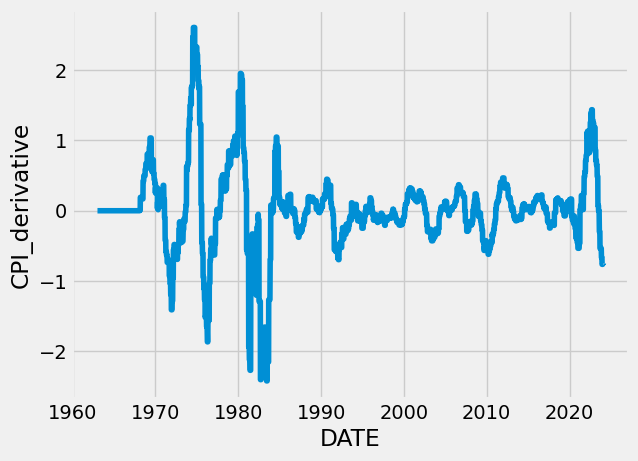

In [81]:
#The derivative of this function would be more useful

#The time period is 8008 days over 31 years. That is a little over 258 days per year.
#We will use 260 workdays as an estimate, since a holiday was recently added to the calendar (Juneteenth in 2021)
financials['moving_CPI'] = financials['CORECPI'] - financials['CORECPI'].shift(260)
financials['moving_CPI'] = financials['moving_CPI'].fillna(method = 'ffill')
financials['CPI_derivative'] = financials['moving_CPI'] / (260)

#Multiply by 100 to by more workable
financials['CPI_derivative'] = financials['CPI_derivative']*100
sb.lineplot(data = financials, x = 'DATE', y = 'CPI_derivative')

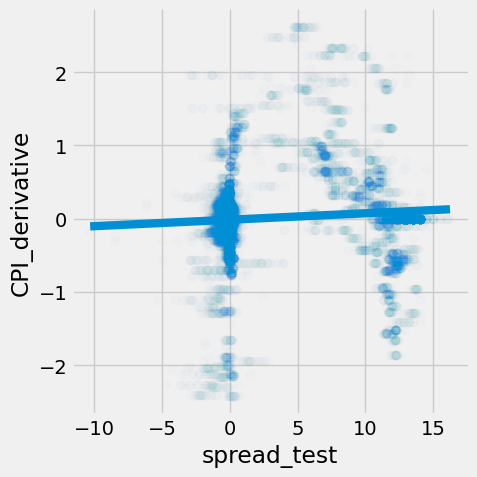

In [83]:
financials['spread_test'] = financials['3M'] - financials['EFFR']
sb.lmplot(data = financials, x = 'spread_test', y = 'CPI_derivative', order = 1, ci = 95, scatter_kws={"alpha": 0.01})

The slope were positive, it would mean that as inflation increases, the difference between the 3-month bond yield and the Federal Effective Funds Rate (EFFR) decreases. This could suggest that with higher inflation, the 3-month bond yield is more likely to be below the EFFR.

This might occur if bond holders expect the Federal Reserve to lower interest rates in response to higher inflation, perhaps to stimulate economic activity. As a result, they might be willing to accept a lower yield on the 3-month bond.

Inflation data clearly makes an impact on bond investor decisions, so we will include it in the model

Unemployment

The federal reserve has 2 main policy objectives and 3 tools to accomplish them. Knowledge of these policy objectives shapes expectations about their usage of each tool. The policy objectives are:

Steady and low inflation (2% target rate)
Low unemployment (equilibrium rate ~ 4-5%)
We have already looked at inflation. I will now import unemployment data as the last part of this dataframe, and then explore its effects.

In [85]:
#Importing UNRATE data
urate = pd.read_csv("UNRATE.csv")

#Change columns on UR
urate.columns = ['DATE', 'UNRATE']
# Chuyển đổi cột 'DATE' sang định dạng ngày tháng
urate['DATE'] = pd.to_datetime(urate['DATE'])

#Merge the filtered data frames
financials = pd.merge(urate, financials, on = 'DATE', how = 'right')

#We fill in the missing data with the forward filling so as not to leak data
financials = financials.fillna(method = 'ffill')

#Part of the data needs to be backfilled -- it's ok since its only a bit
financials = financials.fillna(method = 'bfill')

#Checking again
null_rates = pd.DataFrame(round(financials.isnull().sum()*100/financials.shape[0],2), columns = ['null_count'])
null_rates[null_rates['null_count']>0]

,null_count


<Axes: xlabel='DATE', ylabel='UNRATE'>

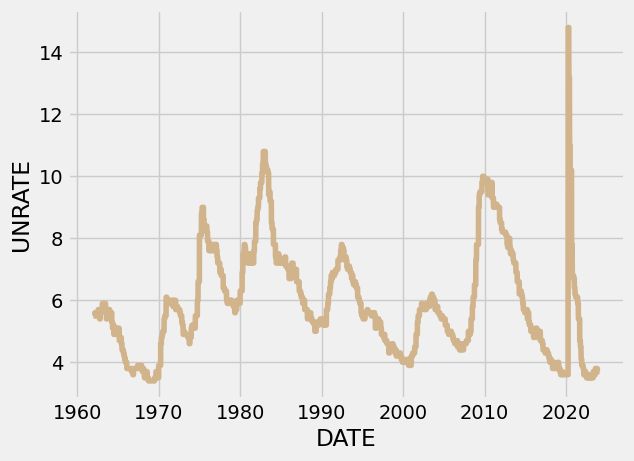

In [89]:
sb.lineplot(data = financials, x = 'DATE', y = 'UNRATE', color='tan')

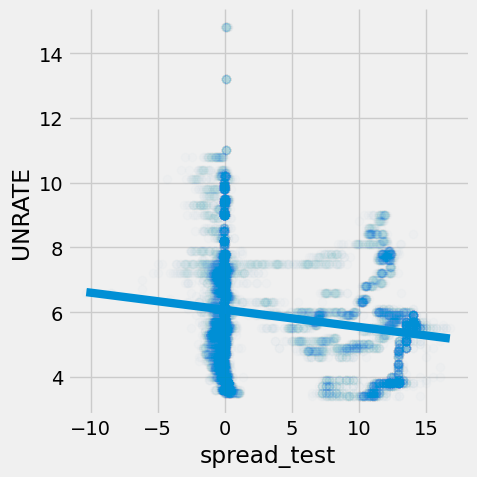

In [90]:
financials['spread_test'] = financials['3M'] - financials['EFFR']
sb.lmplot(data = financials, x = 'spread_test', y = 'UNRATE', order = 1, ci = 99, scatter_kws={"alpha": 0.01})

The negative relationship you’re observing between the “spread_test” (the difference between the 3-month bond yield and the Federal Effective Funds Rate or EFFR) and the unemployment rate (“UNRATE”) could be interpreted as follows:

As the unemployment rate increases, the spread between the 3-month bond yield and the EFFR also tends to increase. This means that when unemployment is high, the yield on the 3-month bond is more likely to be higher than the EFFR.

Investors might expect the EFFR to rise in response to high unemployment because they anticipate that the Federal Reserve will raise interest rates to combat inflation, which can often accompany high unemployment. Higher interest rates can make bonds more attractive to investors, leading to an increase in bond prices.

However, it’s also important to note that traditionally, central banks like the Federal Reserve often cut interest rates in response to high unemployment in an effort to stimulate economic activity. The observation you’ve made is interesting because it seems to contradict this traditional approach.

Please note that this is a simplified explanation and the actual dynamics of financial markets can be much more complex and influenced by a variety of factors. It’s always a good idea to consult with a financial advisor or conduct further research when making investment decisions.

<Axes: xlabel='DATE', ylabel='unemployment_derivative'>

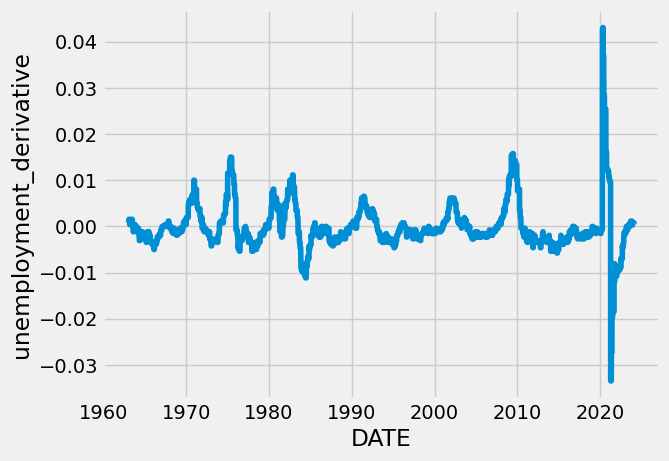

In [91]:
#The derivative of this function may also be useful

#Using 260 working days per year again
financials['moving_u_rate'] = financials['UNRATE'] - financials['UNRATE'].shift(260)
financials['moving_u_rate'] = financials['moving_u_rate'].fillna(method = 'ffill')
financials['unemployment_derivative'] = financials['moving_u_rate'] / (260)
sb.lineplot(data = financials, x = 'DATE', y = 'unemployment_derivative')

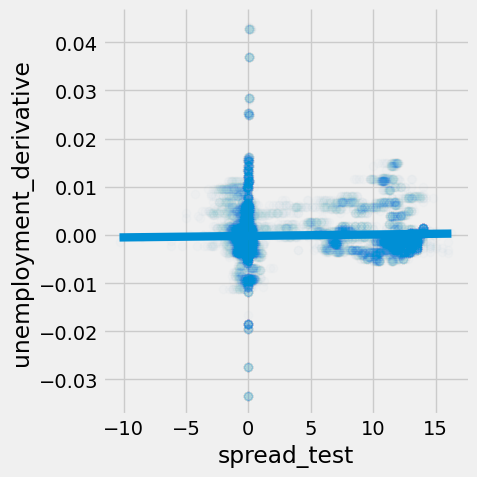

In [92]:
#Similar to before, I will test whether change in unemployment explains the premium demanded for 3 Month bonds

financials['spread_test'] = financials['3M'] - financials['EFFR']
sb.lmplot(data = financials, x = 'spread_test', y = 'unemployment_derivative', order = 1, ci = 99, scatter_kws={"alpha": 0.01})

The derivative turns out to be unrelated to bond premiums

This means the rate of change in unemployment has no affect on future interest rate changes

In conclusion, a model should take into account the EFFR, unemployment %, and inflation in predicting bond yields

# Modelling

In [93]:
financials.columns

Index(['DATE', 'UNRATE', 'CORECPI', '1M', '3M', '6M', '1Y', '2Y', '3Y', '5Y',
       '7Y', '10Y', '20Y', '30Y', 'EFFR', 'moving_CPI', 'CPI_derivative',
       'spread_test', 'moving_u_rate', 'unemployment_derivative'],
      dtype='object')

In [96]:
from scipy.stats import linregress
import matplotlib.pyplot as plt

# Define bonds and their respective months
bonds = ['1M', '3M', '6M', '1Y', '2Y', '3Y', '5Y', '7Y', '10Y', '20Y', '30Y']
bond_months = [1, 3, 6, 12, 24, 36, 60, 84, 120, 240, 360]

maturity = []
slopes = []
intercepts = []
name = []
strength = []

# Iterate over each bond maturity
for b in bonds:
    # Select the interest rate data for the current bond maturity
    x = financials['EFFR'].astype(float)
    y = financials[b].astype(float)
    
    # Perform linear regression
    slope, intercept, r_value, p_value, std_err = linregress(x, y)
    
    # Append results to respective lists
    maturity.append(bond_months[bonds.index(b)])
    name.append(b)
    slopes.append(round(slope, 2))
    intercepts.append(round(intercept, 2))
    strength.append(round(r_value**2, 2))

# Create a dictionary containing the results
results = {
    'Name': name,
    'Maturity (Months)': maturity,
    'EFFR Slope': slopes,
    'EFFR Intercept': intercepts,
    'R-squared': strength
}

# Create a DataFrame from the results dictionary
results_df = pd.DataFrame(data=results)

# Display the DataFrame
results_df


,Name,Maturity (Months),EFFR Slope,EFFR Intercept,R-squared
0,1M,1,0.27,1.53,0.47
1,3M,3,1.10,2.63,0.37
2,6M,6,1.12,2.72,0.38
3,1Y,12,0.90,0.55,0.95
4,2Y,24,0.84,1.45,0.83
5,3Y,36,0.84,1.20,0.90
6,5Y,60,0.79,1.68,0.87
7,7Y,84,0.74,2.42,0.80
8,10Y,120,0.72,2.37,0.81
9,20Y,240,0.65,2.92,0.76


Comparisons

The multiple linear regression model provides slightly better coefficients of determination for all bond maturities, especially as the maturity length increases. This provides strong evidence that incorporating inflation and unemployment into bond yield forcasting is a smart move for investors.

"I expect the policy interest rate in the future with the Fed’s roadmap as follows:

Currently in Q2/2024, the policy interest rate is at 5.25%-5.5%. I expect the first interest rate cut in June 2024 with a decrease of 0.25%. After that, the interest rate reduction roadmap until January 2026 expects the interest rate to be maintained at 3.5% in the long term."

In [110]:
import numpy as np

# Lãi suất EFFR hiện tại (T2/2024)
effr_current = financials['EFFR'].iloc[-1]

# Tạo chuỗi ngày dự đoán từ tháng tiếp theo cho đến tháng 1/2026
future_dates = pd.date_range(start=financials['DATE'].iloc[-1], end='2026-01-01', freq='M')

# Giả định giảm lãi suất 0.25% vào tháng 6/2024
effr_predictions = [effr_current] * len(future_dates)
effr_predictions[5] -= 0.0025  # Giảm 0.25% vào tháng 6/2024

# Giả định duy trì lãi suất ở mức 3.5% cho đến tháng 1/2026
effr_predictions = np.maximum(effr_predictions, 0.035)  # Giữ cho lãi suất tối thiểu là 3.5%

# Dự đoán lãi suất trái phiếu cho từng thời điểm dự đoán EFFR
bond_yields_predictions = []
for effr in effr_predictions:
    bond_yields = []
    for b in bonds:
        slope = results_df.loc[results_df['Name'] == b, 'EFFR Slope'].values[0]
        intercept = results_df.loc[results_df['Name'] == b, 'EFFR Intercept'].values[0]
        bond_yield = slope * effr + intercept
        bond_yields.append(bond_yield)
    bond_yields_predictions.append(bond_yields)

# Tạo DataFrame từ kết quả dự đoán
future_bond_yields_df = pd.DataFrame(bond_yields_predictions, columns=bonds, index=future_dates)

# Hiển thị kết quả dự đoán
future_bond_yields_df.tail(12)


,1M,3M,6M,1Y,2Y,3Y,5Y,7Y,10Y,20Y,30Y
2025-01-31,2.9691,8.493,8.6896,5.347,5.9272,5.6772,5.8907,6.3642,6.2076,6.3845,6.8746
2025-02-28,2.9691,8.493,8.6896,5.347,5.9272,5.6772,5.8907,6.3642,6.2076,6.3845,6.8746
2025-03-31,2.9691,8.493,8.6896,5.347,5.9272,5.6772,5.8907,6.3642,6.2076,6.3845,6.8746
2025-04-30,2.9691,8.493,8.6896,5.347,5.9272,5.6772,5.8907,6.3642,6.2076,6.3845,6.8746
2025-05-31,2.9691,8.493,8.6896,5.347,5.9272,5.6772,5.8907,6.3642,6.2076,6.3845,6.8746
2025-06-30,2.9691,8.493,8.6896,5.347,5.9272,5.6772,5.8907,6.3642,6.2076,6.3845,6.8746
2025-07-31,2.9691,8.493,8.6896,5.347,5.9272,5.6772,5.8907,6.3642,6.2076,6.3845,6.8746
2025-08-31,2.9691,8.493,8.6896,5.347,5.9272,5.6772,5.8907,6.3642,6.2076,6.3845,6.8746
2025-09-30,2.9691,8.493,8.6896,5.347,5.9272,5.6772,5.8907,6.3642,6.2076,6.3845,6.8746
2025-10-31,2.9691,8.493,8.6896,5.347,5.9272,5.6772,5.8907,6.3642,6.2076,6.3845,6.8746


In [115]:
import numpy as np
import pandas as pd

# Giả định duy trì lãi suất ở mức 3.5% từ tháng 1/2026 cho đến năm 2034
effr_2034 = 0.035 * np.ones(12 * 8)  # 12 tháng/năm * 8 năm = 96 tháng
effr_predictions_extended = np.concatenate([effr_predictions, effr_2034])

# Dự đoán lãi suất trái phiếu cho từng thời điểm dự đoán EFFR
bond_yields_predictions_extended = []
for effr in effr_predictions_extended:
    bond_yields = []
    for b in bonds:
        slope = results_df.loc[results_df['Name'] == b, 'EFFR Slope'].values[0]
        intercept = results_df.loc[results_df['Name'] == b, 'EFFR Intercept'].values[0]
        bond_yield = slope * effr + intercept
        bond_yields.append(bond_yield)
    bond_yields_predictions_extended.append(bond_yields)

# Tạo DataFrame từ kết quả dự đoán mở rộng
future_dates_extended = pd.date_range(start=financials['DATE'].iloc[-1], periods=len(effr_predictions_extended), freq='M')
future_bond_yields_df_extended = pd.DataFrame(bond_yields_predictions_extended, columns=bonds, index=future_dates_extended)

# Hiển thị kết quả dự đoán mở rộng
future_bond_yields_df_extended.tail(12*8)  # Hiển thị cho 8 năm tiếp theo


,1M,3M,6M,1Y,2Y,3Y,5Y,7Y,10Y,20Y,30Y
2026-01-31,1.53945,2.6685,2.7592,0.5815,1.4794,1.2294,1.70765,2.4459,2.3952,2.94275,3.5917
2026-02-28,1.53945,2.6685,2.7592,0.5815,1.4794,1.2294,1.70765,2.4459,2.3952,2.94275,3.5917
2026-03-31,1.53945,2.6685,2.7592,0.5815,1.4794,1.2294,1.70765,2.4459,2.3952,2.94275,3.5917
2026-04-30,1.53945,2.6685,2.7592,0.5815,1.4794,1.2294,1.70765,2.4459,2.3952,2.94275,3.5917
2026-05-31,1.53945,2.6685,2.7592,0.5815,1.4794,1.2294,1.70765,2.4459,2.3952,2.94275,3.5917
...,...,...,...,...,...,...,...,...,...,...,...
2033-08-31,1.53945,2.6685,2.7592,0.5815,1.4794,1.2294,1.70765,2.4459,2.3952,2.94275,3.5917
2033-09-30,1.53945,2.6685,2.7592,0.5815,1.4794,1.2294,1.70765,2.4459,2.3952,2.94275,3.5917
2033-10-31,1.53945,2.6685,2.7592,0.5815,1.4794,1.2294,1.70765,2.4459,2.3952,2.94275,3.5917
2033-11-30,1.53945,2.6685,2.7592,0.5815,1.4794,1.2294,1.70765,2.4459,2.3952,2.94275,3.5917


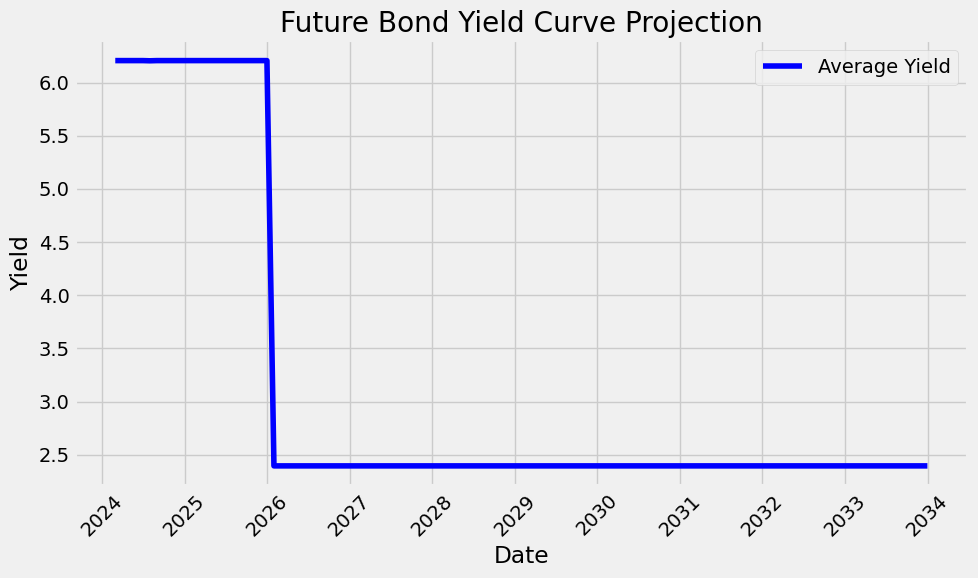

In [121]:
# Calculate the average yield across all bond maturities
average_yield = future_bond_yields_df_extended.median(axis=1)

# Plot the average yield curve
plt.figure(figsize=(10, 6))
plt.plot(average_yield.index, average_yield, label='Average Yield', color='blue')

# Adding labels and title
plt.title('Future Bond Yield Curve Projection')
plt.xlabel('Date')
plt.ylabel('Yield')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()

# Show plot
plt.show()


In [123]:
!pip install ta

Defaulting to user installation because normal site-packages is not writeable


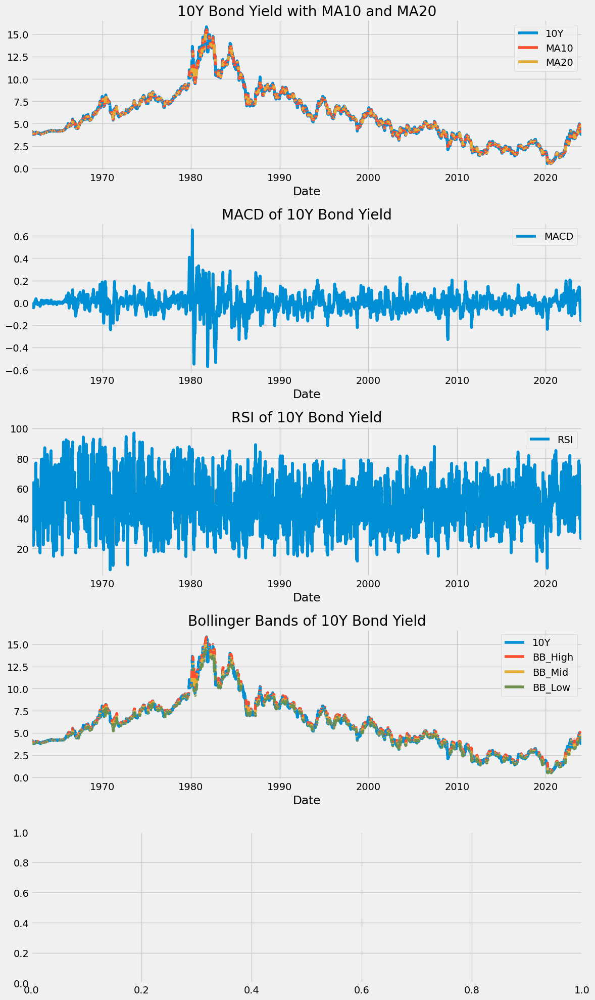

In [124]:
import pandas as pd
import matplotlib.pyplot as plt
import ta

df=dffed

# Calculate technical indicators
df['MA10'] = ta.trend.sma_indicator(df['10Y'], window=10)
df['MA20'] = ta.trend.sma_indicator(df['10Y'], window=20)
df['MACD'] = ta.trend.MACD(df['10Y']).macd()
df['RSI'] = ta.momentum.RSIIndicator(df['10Y']).rsi()
df['BB_High'], df['BB_Mid'], df['BB_Low'] = ta.volatility.BollingerBands(df['10Y']).bollinger_hband(), ta.volatility.BollingerBands(df['10Y']).bollinger_mavg(), ta.volatility.BollingerBands(df['10Y']).bollinger_lband()

# Plotting
fig, axs = plt.subplots(5, figsize=(12, 20))

# Plot MAs
df[['10Y', 'MA10', 'MA20']].plot(ax=axs[0])
axs[0].set_title('10Y Bond Yield with MA10 and MA20')

# Plot MACD
df[['MACD']].plot(ax=axs[1])
axs[1].set_title('MACD of 10Y Bond Yield')

# Plot RSI
df[['RSI']].plot(ax=axs[2])
axs[2].set_title('RSI of 10Y Bond Yield')

# Plot Bollinger Bands
df[['10Y', 'BB_High', 'BB_Mid', 'BB_Low']].plot(ax=axs[3])
axs[3].set_title('Bollinger Bands of 10Y Bond Yield')


plt.tight_layout()
plt.show()


# Fitting Spot Rates with Nelson Siegel and Nelson Siegel Svensson models

In this project, the second on the Nelson-Siegel-Svensson model, I aim to fit a given spot curve.

The standard approach to fit a given curve with the NSS model is to set values for $T1$ and $T2$ (in equations (1) and (2) below), and then run linear regressions to estimate the betas (in equations (1) and (2)). In fact, once $T1$ and $T2$ are fixed, the models become linear.

By doing this over a selected range of values for $T1$ and $T2$, I should be able to select that combination of betas and Ts with the lowest mean square errors.

The spot curve we extracted from the previous notebook is perfect for this exercise as it is very non-linear.

I write below the two parametric functions for the zero rate $r(0,t)$ I used in the previous workbook.

In the Nelson Siegel and Nelson Siegel Svensson models, the zero rate respectively follows the parametric equations:

\begin{equation} (1) \text{Nelson Siegel} :  
r(0,t) = \beta_0 + \beta_1\left(\frac{1-e^{-t/T_1}}{t/T_1} \right) + \beta_2\left(\frac{1-e^{-t/T_1}}{t/T_1} - e^{-t/T_1} \right) \end{equation}

\begin{equation} (2) \text{Nelson Siegel Svensson} :
r(0,t) = \beta_0 + \beta_1\left(\frac{1-e^{-t/T_1}}{t/T_1} \right) + \beta_2\left(\frac{1-e^{-t/T_1}}{t/T_1} - e^{-t/T_1} \right) + 
\beta_3 \left( \frac{1-e^{-t/T_2}}{t/T_2} -e^{-t/T_2} \right)
\end{equation}

where:

-  $r(0,t)$: zero rate with maturity $t$
-  $\beta_0$: level parameter, the long term rate
-  $\beta_1$: slope parameter, the spread short/long-term
-  $\beta_2$: first curvature or hump parameter
-  $\beta_3$: second curvature or hump parameter which allows for a better fit at long maturities

-  $T_1$: scale parameter which affects both the slope and first curvature $\beta_1$ and $\beta_2$
-  $T_2$: scale parameter for the second hump parameter $\beta_3$

Note that $T_2$ and $\beta_3$ are only valid for the NSS model.


In [125]:
!pip install nelson_siegel_svensson


Defaulting to user installation because normal site-packages is not writeable


In [143]:
import numpy as np
from scipy import optimize

class NelsonSiegelModels(object):
    def __init__(self, size):
        self.r         = np.zeros(size)
        self.df        = np.zeros(size)
            
    def Load_CF_Prices(self,time_, Cashflows_, Prices_):
        self.time      = np.asarray(time_)
        self.Cashflows = np.asarray(Cashflows_)
        self.Prices    = np.asarray(Prices_)
    
    def set_ws(self,w_):
        pass
    
    def set_NL(self,NL_):
        pass
        
    def set_NL0(self,NL_):
        pass

    def set_NL1(self,NL_):
        pass

    def DF(self):
        self.df = np.exp(-self.r * self.time)        
        
    def zerorate(self, t):
        pass
  
    def ols(self, t):        
        pass
    
    def Zerorates(self):
        t      = self.time        
        vfunc = np.vectorize(self.zerorate)        
        self.r = vfunc(t)
    
    def loss(self, w):
        self.w = w
        self.Zerorates()
        self.DF()       
        Ax     = np.transpose(self.df).dot(self.Cashflows)
        error  = (self.Prices - Ax)**2                
        return np.mean(error)
    
    def Calibrate(self, initialguess):
        self.opt_results = optimize.minimize(self.loss,np.array(initialguess),jac=False,tol=1e-13,method='L-BFGS-B')
        self.w           = self.opt_results.x 
        
class NelsonSiegelSvensson(NelsonSiegelModels):
    def __init__(self, size):
        NelsonSiegelModels.__init__(self, size)
        self.NL  = np.zeros(2)
        self.w   = np.zeros(4)
    
    def set_ws(self,w_):
        self.w = w_
    
    def set_NL0(self,NL_):
        self.NL[0] = NL_

    def set_NL1(self,NL_):
        self.NL[1] = NL_
   
    def zerorate(self, t):
        vec = self.ols(t)        
        return self.w[0]*vec[0] + self.w[1] * vec[1] + self.w[2] * vec[2] + self.w[3] * vec[3]
    
    def ols(self, t):        
        a = 1.0
        b = ( (1-np.exp(-t/self.NL[0])) / (t/self.NL[0]))
        c = ( (1-np.exp(-t/self.NL[0])) / (t/self.NL[0]) - np.exp(-t/self.NL[0]) ) 
        d = ( (1-np.exp(-t/self.NL[1])) / (t/self.NL[1]) - np.exp(-t/self.NL[1]) )
        return np.asarray([a, b, c, d])

# and let's do the same for the Nelson Siegel algo
class NelsonSiegel(NelsonSiegelModels):
    def __init__(self, size):
        NelsonSiegelModels.__init__(self, size)
        self.NL  = np.zeros(1)
        self.w   = np.zeros(3)
            
    def set_ws(self, w_):
        self.w = w_
        
    def set_NL(self,NL_):
        self.NL = [NL_]
                
    def zerorate(self, t):        
        vec = self.ols(t)
        return self.w[0] * vec[0] + self.w[1] * vec[1] + self.w[2] * vec[2]
    
    def ols(self, t):
        a = 1.0
        b = ( (1-np.exp(-t/self.NL[0])) / (t/self.NL[0]) )
        c = ( (1-np.exp(-t/self.NL[0])) / (t/self.NL[0]) - np.exp(-t/self.NL[0]))        
        return np.asarray([a, b, c])

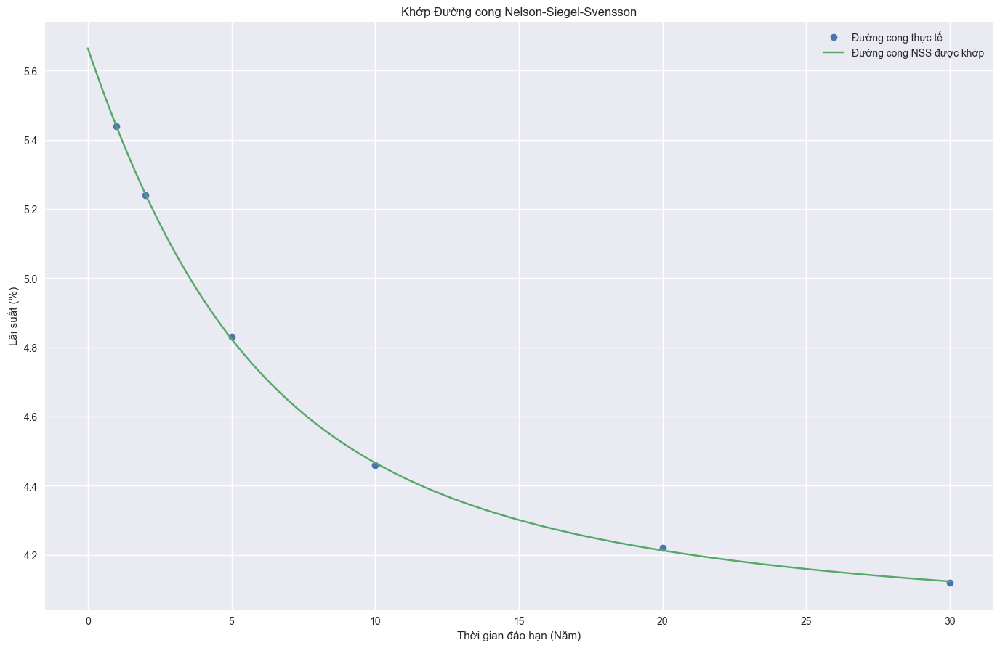

In [144]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from nelson_siegel_svensson.calibrate import calibrate_ns_ols

# Đảm bảo rằng 'y' có cùng độ dài với 't'
t = np.array([1, 2, 5, 10, 20, 30], dtype='float')
y = np.array(df.sort_values('Date').iloc[len(df)-4, 1:len(t)+1], dtype='float')

# Xử lý hiệu quả các giá trị NaN
y = np.nan_to_num(y)

curva, status = calibrate_ns_ols(t, y)
assert status.success

# Cải thiện trực quan hóa biểu đồ
plt.style.use(['seaborn'])
with plt.style.context('seaborn'):
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(15,10))
    ax.plot(t,y,'o', label='Đường cong thực tế')
    t2 = np.linspace(0,max(t),500)
    ax.plot(t2 ,curva(t2),'-', label='Đường cong NSS được khớp')
    ax.set_title('Khớp Đường cong Nelson-Siegel-Svensson')
    ax.set_xlabel('Thời gian đáo hạn (Năm)')
    ax.set_ylabel('Lãi suất (%)')
    ax.legend()

plt.show()


Optimized parameters: [ 1.  -0.1  0.3  0.3  3.  10. ]


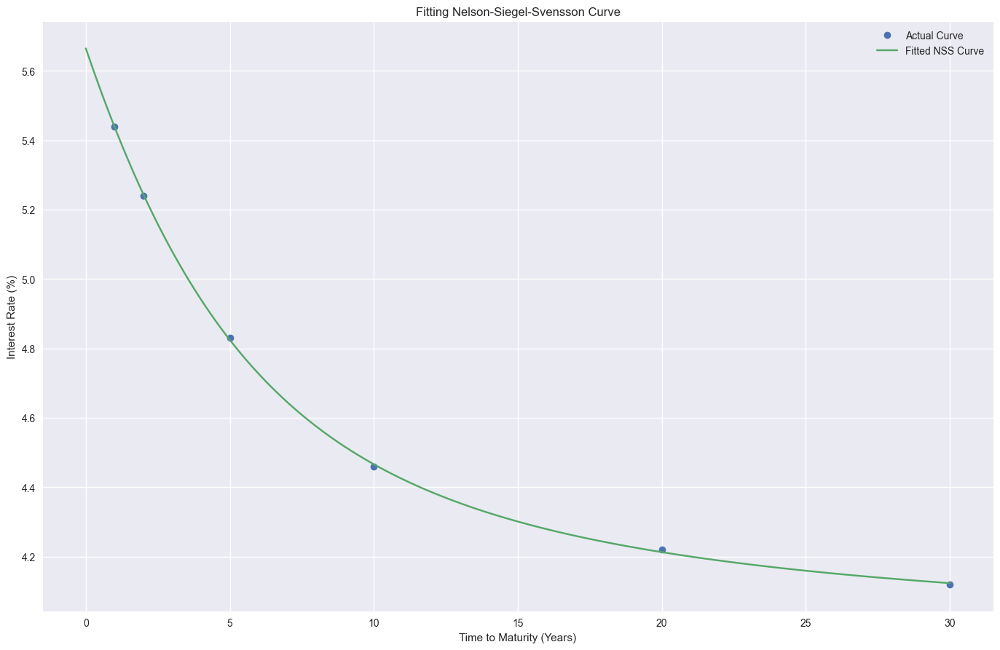

In [145]:
from scipy.optimize import minimize

# Define the loss function based on the squared error
def loss_function(params, t, y):
    b0, b1, b2, b3, t1, t2 = params
    predicted = curva(t)  # Using the calibrated NSS curve
    return np.sum((predicted - y) ** 2)

# Initialize initial values for parameters
initial_guess = np.array([1, -0.1, 0.3, 0.3, 3, 10])

# Optimize parameters using L-BFGS-B method
result = minimize(loss_function, initial_guess, args=(t, y), method='L-BFGS-B', bounds=((-np.inf, np.inf), (-np.inf, np.inf), (-np.inf, np.inf), (-np.inf, np.inf), (0.01, None), (0.01, None)))

# Get the optimized parameters
b_optimized = result.x
print("Optimized parameters:", b_optimized)

# Plot the graph
plt.figure(figsize=(15, 10))
plt.plot(t, y, 'o', label='Actual Curve')
plt.plot(t2, curva(t2), '-', label='Fitted NSS Curve')
plt.xlabel('Time to Maturity (Years)')
plt.ylabel('Interest Rate (%)')
plt.title('Fitting Nelson-Siegel-Svensson Curve')
plt.legend()
plt.show()


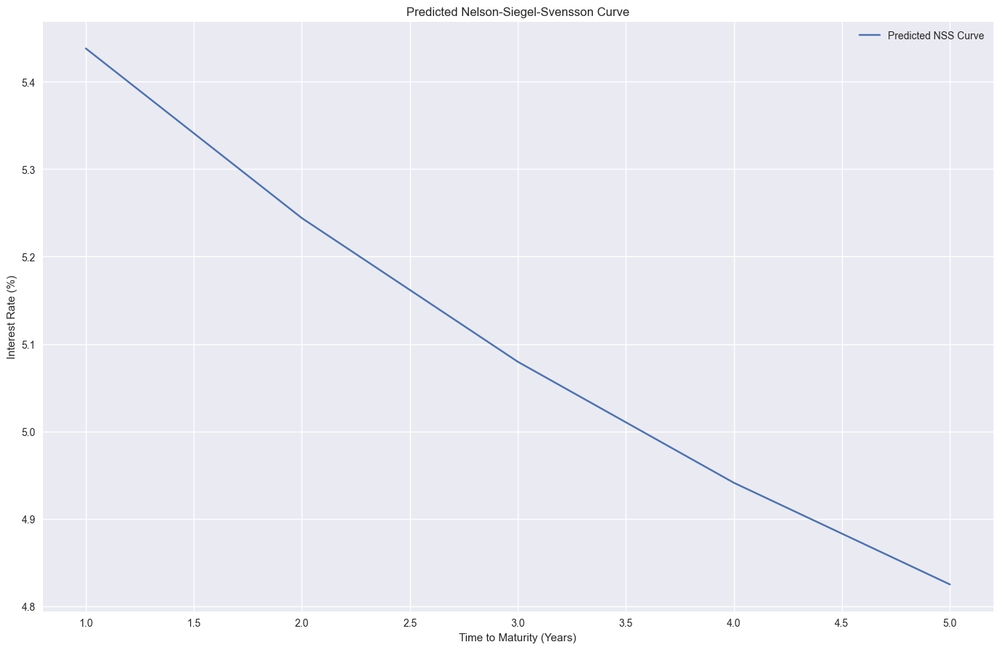

In [146]:
# Dự đoán cấu trúc của đường cong lãi suất cho chuỗi thời gian mới
predicted_rates = curva(new_t)

# Vẽ biểu đồ dự đoán
plt.figure(figsize=(15, 10))
plt.plot(new_t, predicted_rates, '-', label='Predicted NSS Curve')
plt.xlabel('Time to Maturity (Years)')
plt.ylabel('Interest Rate (%)')
plt.title('Predicted Nelson-Siegel-Svensson Curve')
plt.legend()
plt.show()


In [147]:
from scipy.stats import jarque_bera

# Đánh giá tính phân phối chuẩn của sai số
residuals = y - curva(t)
jb_value, p_value = jarque_bera(residuals)

print("Jarque-Bera test statistic:", jb_value)
print("p-value:", p_value)

if p_value < 0.05:
    print("Reject null hypothesis: residuals are not normally distributed")
else:
    print("Fail to reject null hypothesis: residuals are normally distributed")


Jarque-Bera test statistic: 0.6692099438964574
p-value: 0.7156207207837587
Fail to reject null hypothesis: residuals are normally distributed


Kết quả của Jarque-Bera test statistic là 0.669 và p-value là 0.716. Vì p-value lớn hơn mức ý nghĩa thông thường 0.05, nên chúng ta không thể bác bỏ giả thuyết không phân phối chuẩn của sai số. Điều này ngụ ý rằng có sự khả năng cao rằng sai số tuân theo phân phối chuẩn. Do đó, dựa trên kiểm định này, có thể kết luận rằng mô hình phù hợp với dữ liệu và có thể được sử dụng để dự đoán cấu trúc của đường cong lãi suất trong tương lai

In [149]:
from sklearn.metrics import mean_squared_error
import math

# Tính RMSE
predicted_y = curva(t)  # Dự đoán lãi suất sử dụng model Nelson-Siegel-Svensson
rmse = math.sqrt(mean_squared_error(y, predicted_y))
print("RMSE:", rmse)


RMSE: 0.004989367660471312


In [151]:
from sklearn.metrics import r2_score

# Tính R-squared
predicted_y = curva(t)  # Dự đoán lãi suất sử dụng model Nelson-Siegel-Svensson
r_squared = r2_score(y, predicted_y)
print("R-squared:", r_squared)


R-squared: 0.999898975703993


In [152]:
# Số lượng quan sát
n = len(y)

# Số lượng tham số trong mô hình
num_params = len(b_optimized)

# Tính AIC
aic = n * math.log(rmse**2) + 2 * num_params
print("AIC:", aic)


AIC: -51.60535318316367


In [153]:
# Tính BIC
bic = n * math.log(rmse**2) + num_params * math.log(n)
print("BIC:", bic)


BIC: -52.854796367795345


Kết quả đánh giá hiệu suất của mô hình như sau:

- **Root Mean Squared Error (RMSE)**: Giá trị RMSE là 0.00499. Điều này chỉ ra rằng mô hình có sự sai số trung bình rất nhỏ khi so sánh với dữ liệu thực tế, cho thấy mô hình có khả năng dự đoán tốt.

- **R-squared (R²)**: R-squared là 0.9999, gần với 1. Điều này chỉ ra rằng mô hình giải thích tốt sự biến động của dữ liệu, và phần lớn biến thiên của dữ liệu đã được mô hình hóa bởi mô hình.

- **Akaike Information Criterion (AIC)**: Giá trị AIC là -51.605. AIC là một phép đo mức độ phù hợp tương đối của mô hình, và giá trị thấp hơn cho thấy mô hình tốt hơn. Trong trường hợp này, giá trị âm của AIC cho thấy mô hình có khả năng tốt để dự đoán dữ liệu.

- **Bayesian Information Criterion (BIC)**: Giá trị BIC là -52.855. Tương tự như AIC, BIC cũng là một phép đo mức độ phù hợp tương đối của mô hình, và giá trị thấp hơn cho thấy mô hình tốt hơn. Trong trường hợp này, giá trị âm của BIC cũng cho thấy mô hình có khả năng tốt để dự đoán dữ liệu.

Tổng thể, dựa trên các phép đo này, mô hìn|h Nelson-Siegel-Svensson có vẻ phù hợp và hiệu suất tốt khi dự đoán cấu trúc của đường cong lãi suất.